In [1]:
import numpy as np
import pandas as pd
pd.set_option('display.max_colwidth', 1000)
pd.set_option('display.max_columns', None)

# Imports for scraping data
import re
import requests
from bs4 import BeautifulSoup as bs

# Imports for plots
import matplotlib.pyplot as plt
import seaborn as sns

# Networkx
import networkx as nx
from networkx.algorithms import bipartite

# Community Detection packages
import community as community_louvain
import matplotlib.cm as cm
import colorlover as cl

# Import Dimensionality Reduction libraries
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

# Import Clustering Algorithms 
from sklearn.cluster import KMeans 

# To visualize Silhouette scores
from yellowbrick.cluster import SilhouetteVisualizer

# Cluster evaluation metrics
from sklearn.metrics import silhouette_score

# Plotly library
# from plotly.offline import download_plotlyjs, init_notebook_mode, iplot
# import plotly.graph_objs as go
# import plotly
# import plotly.express as px
# init_notebook_mode(connected=True)


import warnings
warnings.filterwarnings('ignore')

In [2]:
# Function to get the data from the HMDB website
# def get_data(url):
#     full_page = pd.read_html(url)
#     print(len(full_page))
#     return full_page   

In [3]:
#cancer1 = get_data("https://hmdb.ca/diseases?disease=1&disease_list=cancer&filter=true&metabolite_list=")

In [4]:
# Function to get the disease name
# def get_disease_names(url):
#     response = requests.get(url)
#     results = bs(response.content)
#     diseases = results.select("strong")

#     disease_names = [disease.get_text(strip=True) for disease in diseases]
    
#     df = pd.DataFrame({"disease": disease_names})
#     df.disease = df.disease.str.replace(r"\s*\(\d+\)", '', regex=True)
#     return df

In [5]:
#cancer1_diseases = get_disease_names("https://hmdb.ca/diseases?disease=1&disease_list=cancer&filter=true&metabolite_list=")

In [6]:
# Drop irrelevant data from scraping
#cancer1_diseases.drop(index=cancer1_diseases.iloc[-2:].index, inplace=True)

In [7]:
# Function to create a DF from the scraping results with the associated type of disease
# def make_df_from_results(cancer_results, cancer_diseases):
#     all_data = pd.DataFrame()
#     for i in range(len(cancer_diseases)):
#         df = cancer_results[i]
#         df["Disease"] = cancer_diseases.disease[i]
#         df = df.drop(columns="Details")
#         all_data = pd.concat([all_data, df], axis=0).reset_index(drop=True)
#     return all_data

In [8]:
#cancer1_df = make_df_from_results(cancer1, cancer1_diseases)

In [9]:
#cancer2 = get_data("https://hmdb.ca/diseases?disease=1&disease_list=cancer&filter=true&metabolite_list=&page=2")

In [10]:
#cancer2_diseases = get_disease_names("https://hmdb.ca/diseases?disease=1&disease_list=cancer&filter=true&metabolite_list=&page=2")

In [11]:
# Drop irrelevant data from scraping
#cancer2_diseases.drop(index=cancer2_diseases.iloc[-1:].index, inplace=True)

In [12]:
#cancer2_df = make_df_from_results(cancer2, cancer2_diseases)

In [13]:
# Combine cancers data from page 1 and page 2
#all_cancers = pd.concat([cancer1_df, cancer2_df], axis=0).reset_index(drop=True)

all_cancers.to_csv("./all_cancers_metabolites.csv", index=False)

In [14]:
all_cancers = pd.read_csv("../data/all_cancers_metabolites.csv")

In [15]:
# Extract the Metabolite ID from the Metabolite name into a separate column
all_cancers[["Metabolite", "ID"]] = all_cancers.Metabolite.str.extract(r'^(.*)\s\((HMDB\d+)\)$')

In [16]:
all_cancers_df = all_cancers.copy()

In [17]:
all_cancers_df.drop(columns=["Sex", "Age", "Patient Status", "Concentration", "Biospecimen"], inplace=True)

In [18]:
all_cancers_df.Metabolite.nunique()

903

In [19]:
all_cancers_df.ID.nunique()

903

In [20]:
# Create new DF grouped by Metabolite name and Disease
metabolites_grouped = all_cancers_df.groupby(["Metabolite", "Disease", "ID"]).first().reset_index()

In [21]:
# After grouping, duplicates are combined
metabolites_grouped

,Metabolite,Disease,ID
0,"(R)-2,3-Dihydroxy-isovalerate",Colorectal cancer,HMDB0012141
1,(R)-2-Hydroxycaprylic acid,Colorectal cancer,HMDB0002264
2,(R)-Salsolinol,Colorectal cancer,HMDB0005199
3,(S)-3-Hydroxyisobutyric acid,Colorectal cancer,HMDB0000023
4,(S)-Homostachydrine,Colorectal cancer,HMDB0033433
...,...,...,...
1010,scyllo-Inositol,Colorectal cancer,HMDB0006088
1011,trans-Aconitic acid,Lung Cancer,HMDB0000958
1012,trizma acetate,Colorectal cancer,HMDB0062561
1013,xi-10-Hydroxyoctadecanoic acid,Colorectal cancer,HMDB0037396


In [22]:
unique_cancer_metabolites = metabolites_grouped.drop(columns="Disease")

unique_cancer_metabolites.drop_duplicates(inplace=True)

In [23]:
unique_cancer_metabolites

,Metabolite,ID
0,"(R)-2,3-Dihydroxy-isovalerate",HMDB0012141
1,(R)-2-Hydroxycaprylic acid,HMDB0002264
2,(R)-Salsolinol,HMDB0005199
3,(S)-3-Hydroxyisobutyric acid,HMDB0000023
4,(S)-Homostachydrine,HMDB0033433
...,...,...
1010,scyllo-Inositol,HMDB0006088
1011,trans-Aconitic acid,HMDB0000958
1012,trizma acetate,HMDB0062561
1013,xi-10-Hydroxyoctadecanoic acid,HMDB0037396


In [24]:
# dfs = []

# metabolite_ids = list(metabolites_grouped.ID.unique())
# #metabolite_ids = ["HMDB0012141"]

# for metabolite_id in metabolite_ids:
    
#     url = f"https://hmdb.ca/metabolites/{metabolite_id}"
#     response = requests.get(url)
#     webpage = bs(response.content)
    
#     print(metabolite_id)
    
#     try:
#         table = webpage.select("table.table.table-condensed.table-striped.concentrations")[1]
#     except:
#         try:
#             table = webpage.select("table.table.table-condensed.table-striped.concentrations")[0]
#         except:
#             pass
        
#     columns = table.find("thead").find_all("th") 
#     column_names = [column.string for column in columns] 

#     table_rows = table.find("tbody").find_all("tr")
#     data = []
#     for tr in table_rows:
#         tds = tr.find_all('td')
#         row = [td.get_text().strip() for td in tds] 
#         data.append(row)

#     df = pd.DataFrame(data, columns=column_names)
#     df["ID"] = f"{metabolite_id}"
#     #print(metabolite_id)
#     dfs.append(df)

In [25]:
# Raw associated conditions for each metabolite present in Cancers
#linked_metabolites = pd.concat(dfs, sort=False)

In [26]:
#linked_metabolites.reset_index(drop=True, inplace=True)

linked_metabolites.to_csv("./all_linked_metabolites.csv", index=False)

In [27]:
linked_metabolites = pd.read_csv("../data/all_linked_metabolites.csv")

In [28]:
linked_conditions = linked_metabolites.filter(["ID", "Condition"])

In [29]:
linked_conditions = linked_conditions.groupby(["ID", "Condition"]).first().reset_index()

In [30]:
linked_conditions

,ID,Condition
0,HMDB0000002,Breast cancer
1,HMDB0000002,Colorectal Cancer
2,HMDB0000002,Leukemia
3,HMDB0000008,Alzheimer's disease
4,HMDB0000008,Colorectal Cancer
...,...,...
5622,HMDB0240252,Cancer patients undergoing total body irradiation
5623,HMDB0240252,Colorectal cancer
5624,HMDB0240261,Colorectal Cancer
5625,HMDB0240261,Colorectal cancer


In [31]:
cancers_id = metabolites_grouped.filter(["ID", "Disease"])

In [32]:
cancers_id.rename(columns={"Disease": "Condition"}, inplace=True)

In [33]:
cancers_id

,ID,Condition
0,HMDB0012141,Colorectal cancer
1,HMDB0002264,Colorectal cancer
2,HMDB0005199,Colorectal cancer
3,HMDB0000023,Colorectal cancer
4,HMDB0033433,Colorectal cancer
...,...,...
1010,HMDB0006088,Colorectal cancer
1011,HMDB0000958,Lung Cancer
1012,HMDB0062561,Colorectal cancer
1013,HMDB0037396,Colorectal cancer


In [34]:
# Cancers + Associated Conditions
all_conditions = pd.concat([cancers_id, linked_conditions], axis=0)
#all_conditions = pd.concat([cancers_id, associated_conditions], axis=0)

In [35]:
all_conditions

,ID,Condition
0,HMDB0012141,Colorectal cancer
1,HMDB0002264,Colorectal cancer
2,HMDB0005199,Colorectal cancer
3,HMDB0000023,Colorectal cancer
4,HMDB0033433,Colorectal cancer
...,...,...
5622,HMDB0240252,Cancer patients undergoing total body irradiation
5623,HMDB0240252,Colorectal cancer
5624,HMDB0240261,Colorectal Cancer
5625,HMDB0240261,Colorectal cancer


In [36]:
all_conditions.Condition = all_conditions.Condition.str.lower()

In [37]:
all_conditions.drop_duplicates(inplace=True)

In [38]:
all_conditions = all_conditions.groupby(["Condition", "ID"]).first().reset_index()

In [39]:
all_conditions

,Condition,ID
0,11-beta-hydroxylase deficiency,HMDB0000053
1,11-beta-hydroxylase deficiency,HMDB0000234
2,11-beta-hydroxylase deficiency,HMDB0001032
3,11-beta-hydroxylase deficiency,HMDB0003231
4,11-beta-hydroxylase deficiency,HMDB0005972
...,...,...
5160,xanthinuria type 1,HMDB0000289
5161,xanthinuria type 1,HMDB0000292
5162,xanthinuria type ii,HMDB0000292
5163,zellweger syndrome,HMDB0000070


In [40]:
# Final DF containing all the Conditions associated with the Cancer Metabolites
all_conditions_matched = all_conditions.merge(unique_cancer_metabolites, how='left', on="ID")

all_conditions_matched.reset_index(drop=True, inplace=True)

In [41]:
# Use this DF for further analysis
all_conditions_matched

,Condition,ID,Metabolite
0,11-beta-hydroxylase deficiency,HMDB0000053,Androstenedione
1,11-beta-hydroxylase deficiency,HMDB0000234,Testosterone
2,11-beta-hydroxylase deficiency,HMDB0001032,Dehydroepiandrosterone sulfate
3,11-beta-hydroxylase deficiency,HMDB0003231,Vaccenic acid
4,11-beta-hydroxylase deficiency,HMDB0005972,Tetrahydrodeoxycortisol
...,...,...,...
5160,xanthinuria type 1,HMDB0000289,Uric acid
5161,xanthinuria type 1,HMDB0000292,Xanthine
5162,xanthinuria type ii,HMDB0000292,Xanthine
5163,zellweger syndrome,HMDB0000070,Pipecolic acid


all_conditions_matched.to_csv("./all_conditions_matched.csv", index=False)

In [42]:
all_conditions_matched = pd.read_csv("../data/all_conditions_matched.csv")

In [43]:
pd.set_option('display.max_rows', None)

In [44]:
final_df = all_conditions_matched.copy()

In [45]:
#final_df.Condition.unique()

In [46]:
drop_list = []

In [47]:
final_df.loc[final_df.Condition.str.contains("missing"), "Condition"] = "dental disorder"

In [48]:
final_df.loc[final_df.Condition.str.contains("tooth"), "Condition"] = "dental disorder"

In [49]:
final_df.loc[final_df.Condition.str.contains("periodontal"), "Condition"] = "periodontal disease"

In [50]:
final_df.loc[final_df.Condition.str.contains("attachment loss"), "Condition"] = "periodontal disease"

In [51]:
final_df.loc[final_df.Condition.str.contains("supragingival"), "Condition"] = "periodontal disease"

In [52]:
final_df.loc[final_df.Condition.str.contains("caries"), "Condition"] = "dental disorder"

In [53]:
final_df.loc[final_df.Condition.str.contains("oral squamous"), "Condition"] = "oral cancer"

In [54]:
final_df.loc[final_df.Condition.str.contains("dementia"), "Condition"] = "dementia"

In [55]:
# Irrelevant Exogenous Factor (Antibiotic administration)
drop_list.extend(final_df.loc[final_df.Metabolite == "Levofloxacin"].index)

In [56]:
final_df.loc[final_df.Condition.str.contains("3-methylglutaconic aciduria"), "Condition"] = "3-methylglutaconic aciduria"

In [57]:
final_df.loc[final_df.Condition == "3-hydroxy-3-methylglutaryl-coa lyase deficiency", "Condition"] = "hmg-coa lyase deficiency"

In [58]:
final_df.loc[final_df.Condition == "3-hydroxy-3- methylglutaryl-coa lyase (hl) deficency", "Condition"] = "hmg-coa lyase deficiency"

In [59]:
final_df.loc[final_df.Condition == "3-hydroxy-3-methylglutaric- coenzyme a lyase deficiency", "Condition"] = "hmg-coa lyase deficiency"

In [60]:
final_df.loc[final_df.Condition == "3-hydroxy-3-methylglutaryl-coa synthase deficiency", "Condition"] = "hmg-coa synthase deficiency"

In [61]:
final_df.loc[final_df.Condition.str.contains("adenosine deaminase"), "Condition"] = "ada deficiency"

In [62]:
final_df.loc[final_df.Condition.str.contains("adenylosuccin"), "Condition"] = "adsl deficiency"

In [63]:
final_df.loc[final_df.Condition.str.contains("adpkd"), "Condition"] = "adpkd"

In [64]:
final_df.loc[final_df.Condition.str.contains("adrenal hyperplasia, congenital"), "Condition"] = "CAH"

In [65]:
final_df.loc[final_df.Condition.str.contains("congenital adrenal"), "Condition"] = "CAH"

In [66]:
final_df.loc[final_df.Condition.str.contains("adrenal insuff"), "Condition"] = "congenital adrenal insufficiency (46,xy)"

In [67]:
final_df.loc[final_df.Condition.str.contains("adrenoleukodystrophy"), "Condition"] = "adrenoleukodystrophy"

In [68]:
# Irrelevant Exogenous Factor (post-administration studies)
drop_list.extend(final_df.loc[final_df.Condition.str.contains("after")].index)

In [69]:
# Irrelevant Exogenous Factor (alcohol intoxication)
drop_list.extend(final_df.loc[final_df.Condition == "drunk driver"].index)

In [70]:
final_df.loc[final_df.Condition.str.contains("nafld"), "Condition"] = "nafld"

In [71]:
final_df.loc[final_df.Condition.str.contains("adipic"), "Condition"] = "α-aminoadipic/α-ketoadipic aciduria"

In [72]:
final_df.loc[final_df.Condition == "myopathy, lactic acidosis, and sideroblastic anemia 1", "Condition"] = "mlasa1"

In [73]:
final_df.loc[final_df.Condition.str.contains("homocystinuria-megaloblastic"), "Condition"] = "hmag"          

In [74]:
final_df.loc[final_df.Condition.str.contains("anemia, congenital"), "Condition"] = "cda ii"

In [75]:
final_df.loc[final_df.Condition.str.contains("anorexia"), "Condition"] = "anorexia"

In [76]:
final_df.loc[final_df.Condition.str.contains("argininosuccinic aciduria"), "Condition"] = "argininosuccinic aciduria"

In [77]:
final_df.loc[final_df.Condition == "arginosuccinic aciduria", "Condition"] = "argininosuccinic aciduria"

In [78]:
final_df.loc[final_df.Condition.str.contains("asthma"), "Condition"] = "asthma"

In [79]:
final_df.loc[final_df.Condition == "autosomal recessive spastic ataxia of charlevoix-saguena", "Condition"] = "ARSACS"

In [80]:
final_df.loc[final_df.Condition == "bacterial infections (assorted)", "Condition"] = "bacterial infections"

In [81]:
final_df.loc[final_df.Condition.str.contains("bartter syndrome"), "Condition"] = "bartter syndrome"

In [82]:
final_df.loc[final_df.Condition.str.contains("bph"), "Condition"] = "bph"

In [83]:
final_df.loc[final_df.Condition == "bile acid synthesis defect, congenital, 1", "Condition"] = "CBAS1"

In [84]:
drop_list.extend(final_df.loc[final_df.Condition.str.contains("control")].index)

In [85]:
final_df.loc[final_df.Condition == "cancer patients undergoing total body irradiation", "Condition"] = "cancer (TBI)"

In [86]:
final_df.loc[final_df.Condition == "cancer with metastatic bone disease", "Condition"] = "cancer (MBD)"

In [87]:
final_df.loc[final_df.Condition == "carnitine transporter defect; primary systemic carnitine deficiency", "Condition"] = "primary carnitine deficiency"

In [88]:
final_df.loc[final_df.Condition.str.contains("cerebral creatine"), "Condition"] = "cerebral creatine deficiency syndrome"

In [89]:
final_df.loc[final_df.Condition == "cholestasis, progressive familial intrahepatic, 1", "Condition"] = "PFIC1"

In [90]:
final_df.loc[final_df.Condition == "chondrodysplasia punctata, x-linked dominant", "Condition"] = "CDPX2"

In [91]:
final_df.loc[final_df.Condition.str.contains("chronic progressive"), "Condition"] = "CPEO"

In [92]:
final_df.loc[final_df.Condition.str.contains("citrullinemia"), "Condition"] = "citrullinemia"

In [93]:
final_df.loc[final_df.Condition.str.contains("clostridium"), "Condition"] = "C. difficile infection"

In [94]:
final_df.loc[final_df.Condition == "cholesterol stones", "Condition"] = "gallstone disease"

In [95]:
final_df.loc[final_df.Condition.str.contains("hypercholesterolemia"), "Condition"] = "hypercholesterolemia"

In [96]:
final_df.loc[final_df.Condition.str.contains("coenzyme q10"), "Condition"] = "CoQ10 deficiency"

In [97]:
final_df.loc[final_df.Condition == "colon cancer", "Condition"] = "colorectal cancer"

In [98]:
final_df.loc[final_df.Condition == "combined malonic and methylmalonic aciduria", "Condition"] = "malonic/methylmalonic aciduria"

In [99]:
# Irrelevant Exogenous Factor (Chemotherapy treatment)
drop_list.extend(final_df.loc[final_df.Condition == "colorectal, breast, or neuroendocrine cancer"].index)

In [100]:
final_df.loc[final_df.Condition.str.contains("combined oxidative"), "Condition"] = "COXPD"

In [101]:
final_df.loc[final_df.Condition.str.contains("peritoneal"), "Condition"] = "peritoneal dialysis"

In [102]:
final_df.loc[final_df.Condition.str.contains("artery"), "Condition"] = "coronary artery disease"

In [103]:
final_df.loc[final_df.Condition.str.contains("crohn"), "Condition"] = "crohn's disease"

In [104]:
final_df.loc[final_df.Condition.str.contains("cutis"), "Condition"] = "De Barsy syndrome"

In [105]:
final_df.loc[final_df.Condition.str.contains("cystinuria type"), "Condition"] = "cystinuria"

In [106]:
final_df.loc[final_df.Condition == "deafness, onychodystrophy, osteodystrophy, mental retardation, and seizures syndrome", "Condition"] = "DOORS syndrome"

In [107]:
final_df.loc[final_df.Condition == "deficiency in the 11 beta-hydroxylation of corticosteroids", "Condition"] = "11β-OHD"

In [108]:
final_df.loc[final_df.Condition == "11-beta-hydroxylase deficiency", "Condition"] = "11β-OHD"

In [109]:
final_df.loc[final_df.Condition.str.contains("depres"), "Condition"] = "depression"

In [110]:
final_df.loc[final_df.Condition == "developmental disorder not otherwise specified", "Condition"] = "PDD-NOS"

In [111]:
final_df.loc[final_df.Condition.str.contains("diabetes and deafness"), "Condition"] = "diabetes"

In [112]:
final_df.loc[final_df.Condition.str.contains("diabetes of"), "Condition"] = "diabetes"

In [113]:
final_df.loc[final_df.Condition == "type i diabetes", "Condition"] = "type 1 diabetes mellitus"

final_df.loc[final_df.Condition == "insulin-dependent diabetes mellitus(iddm)", "Condition"] = "type 1 diabetes mellitus"

final_df.loc[final_df.Condition == "diabetes mellitus", "Condition"] = "diabetes"

In [114]:
final_df.loc[final_df.Condition.str.contains("ibs"), "Condition"] = "irritable bowel syndrome (ibs)"

In [115]:
final_df.loc[final_df.Condition.str.contains("preeclampsia"), "Condition"] = "preeclampsia"

In [116]:
final_df.loc[final_df.Condition.str.contains("renal failure"), "Condition"] = "kidney failure"

In [117]:
final_df.loc[final_df.Condition == "epileptic encephalopathy, early infantile, 39", "Condition"] = "DEE39"

In [118]:
final_df.loc[final_df.Condition.str.contains("hypertension"), "Condition"] = "hypertension"

In [119]:
# Irrelevant Exogenous Factor (post-Caffeine studies)
drop_list.extend(final_df.loc[final_df.Condition.str.contains("traumatic brain")].index)

In [120]:
final_df.loc[final_df.Condition.str.contains("gaba"), "Condition"] = "GABA-transaminase deficiency"

In [121]:
final_df.loc[final_df.Condition.str.contains("hypergalactosemia"), "Condition"] = "hypergalactosemia (hepatic)"

In [122]:
final_df.loc[final_df.Condition.str.contains("galactose-"), "Condition"] = "galactosemia"

In [123]:
final_df.loc[final_df.Condition == "galactosemia type 1", "Condition"] = "galactosemia"

In [124]:
final_df.loc[final_df.Condition == "genetically at-risk of celiac disease", "Condition"] = "celiac disease"

In [125]:
final_df.loc[final_df.Condition == "glucose transporter type 1 deficiency syndrome", "Condition"] = "Glut1DS"

In [126]:
final_df.loc[final_df.Condition == "glucose-6-phosphate dehydrogenase deficiency", "Condition"] = "G6PD deficiency"

In [127]:
final_df.loc[final_df.Condition == "glut1 deficiency syndrome", "Condition"] = "Glut1DS"

In [128]:
final_df.loc[final_df.Condition.str.contains("2-hydroxyglu"), "Condition"] = "2-hydroxyglutaric aciduria"

In [129]:
final_df.loc[final_df.Condition == "glutaric acidemia type 2", "Condition"] = "glutaric aciduria ii"

In [130]:
final_df.loc[final_df.Condition == "glutaric aciduria type iii", "Condition"] = "glutaryl-coa oxidase deficiency"

In [131]:
final_df.loc[final_df.Condition == "glutaric aciduria i", "Condition"] = "glutaryl-coa dehydrogenase deficiency"

In [132]:
final_df.loc[final_df.Condition.str.contains("gdhd"), "Condition"] = "glutaryl-coa dehydrogenase deficiency"

In [133]:
final_df.loc[final_df.Condition.str.contains("heart failure"), "Condition"] = "heart failure"

In [134]:
final_df.loc[final_df.Condition.str.contains("hemodialysis"), "Condition"] = "hemodialysis"

In [135]:
final_df.loc[final_df.Condition.str.contains("hepatocellular"), "Condition"] = "hepatocellular carcinoma"

In [136]:
final_df.loc[final_df.Condition.str.contains("cryptosporidium"), "Condition"] = "cryptosporidiosis"

In [137]:
final_df.loc[final_df.Condition == "hyperglycinaemia", "Condition"] = "hyperglycinemia"

In [138]:
final_df.loc[final_df.Condition == "hyperglycinemia, lactic acidosis, and seizures", "Condition"] = "HGCLAS"

In [139]:
final_df.loc[final_df.Condition.str.contains("hyperglycinemia"), "Condition"] = "hyperglycinemia"

In [140]:
final_df.loc[final_df.Condition == "hyperinsulinemic hypoglycemia, familial, 1, hhf1", "Condition"] = "HHF1"

In [141]:
final_df.loc[final_df.Condition.str.contains("hyperlipid"), "Condition"] = "hyperlipidemia"

In [142]:
final_df.loc[final_df.Condition.str.contains("hyperlysinemia ii"), "Condition"] = "hyperlysinemia ii"

In [143]:
final_df.loc[final_df.Condition == "hyperlysinemia i, familial", "Condition"] = "hyperlysinemia i"

In [144]:
final_df.loc[final_df.Condition == "hyperornithinemia with gyrate atrophy", "Condition"] = "hyperornithinemia"

In [145]:
final_df.loc[final_df.Condition == "hyperornithinemia–hyperammonemia-homocitrullinuria syndrome", "Condition"] = "HHH syndrome"

In [146]:
final_df.loc[final_df.Condition.str.contains("hyperphenylalaninemia"), "Condition"] = "hyperphenylalaninemia"

In [147]:
final_df.loc[final_df.Condition.str.contains("hyperprolinemia"), "Condition"] = "hyperprolinemia"

In [148]:
final_df.loc[final_df.Condition == "hypoglycemia, familial neonatal", "Condition"] = "hypoglycemia"

In [149]:
final_df.loc[final_df.Condition.str.contains("hepatitis"), "Condition"] = "hepatitis"

In [150]:
final_df.loc[final_df.Condition.str.contains("igan"), "Condition"] = "Berger's disease"

In [151]:
final_df.loc[final_df.Condition.str.contains("refsum"), "Condition"] = "refsum's disease"

In [152]:
final_df.loc[final_df.Condition.str.contains("irritable"), "Condition"] = "irritable bowel syndrome"

In [153]:
final_df.loc[final_df.Condition == "leigh syndrome, french canadian type", "Condition"] = "leigh syndrome"

In [154]:
final_df.loc[final_df.Condition == "leigh's syndrome", "Condition"] = "leigh syndrome"

In [155]:
final_df.loc[final_df.Condition.str.contains("leuprolide"), "Condition"] = "hypogonadism"

In [156]:
final_df.loc[final_df.Condition.str.contains("lipodystrophy"), "Condition"] = "lipodystrophy"

In [157]:
final_df.loc[final_df.Condition == "long-chain fatty acids, defect in transport of", "Condition"] = "primary carnitine deficiency"

In [158]:
final_df.loc[final_df.Condition.str.contains("lysinuric"), "Condition"] = "lysinuric protein intolerance"

In [159]:
final_df.loc[final_df.Condition.str.contains("maple"), "Condition"] = "MSUD"

In [160]:
final_df.loc[final_df.Condition.str.contains("medium"), "Condition"] = "MCAD deficiency"

In [161]:
final_df.loc[final_df.Condition == "metabolic encephalomyopathic crises, recurrent, with rhabdomyolysis, cardiac arrhythmias, and neurodegeneration", "Condition"] = "MECRCN"

In [162]:
final_df.loc[final_df.Condition.str.contains("mitochondrial complex"), "Condition"] = "ACAD9 deficiency"

In [163]:
final_df.loc[final_df.Condition == "mitochondrial encephalomyopaththy with elevanted methylmalonic acid, sucla2", "Condition"] = "MMA mitochondrial encephalomyopathy (sucla2)"

In [164]:
final_df.loc[final_df.Condition == "mitochondrial-encephalopathy-lactic acidosis-stroke", "Condition"] = "MELAS"

In [165]:
final_df.loc[final_df.Condition == "methylmalonic aciduria mitochondrial encephelopathy leigh-like", "Condition"] = "MMA mitochondrial encephelopathy (leigh-like)"

In [166]:
final_df.loc[final_df.Condition.str.contains("molybden"), "Condition"] = "molybdenum cofactor deficiency"

In [167]:
# Irrelevant Exogenous Factor (Morphine treatment studies)
drop_list.extend(final_df.loc[final_df.Condition == "morphine treatment"].index)

In [168]:
# Irrelevant Exogenous Factor
drop_list.extend(final_df.loc[final_df.Condition == "normal"].index)

In [169]:
final_df.loc[final_df.Condition.str.contains("obes"), "Condition"] = "obesity"

In [170]:
final_df.loc[final_df.Condition.str.contains("transcarbamylase"), "Condition"] = "OTC deficiency"

In [171]:
final_df.loc[final_df.Condition == "otc-deficiency", "Condition"] = "OTC deficiency"

In [172]:
final_df.loc[final_df.Condition.str.contains("orotic"), "Condition"] = "hereditary orotic aciduria"

In [173]:
final_df.loc[final_df.Condition == "overweight", "Condition"] = "obesity"

In [174]:
final_df.loc[final_df.Condition.str.contains("pancreatic"), "Condition"] = "pancreatic cancer"

In [175]:
final_df.loc[final_df.Condition.str.contains("parkinson"), "Condition"] = "parkinson's disease"

In [176]:
final_df.loc[final_df.Condition.str.contains("peroxisomal"), "Condition"] = "peroxisome biogenesis disorder"

In [177]:
final_df.loc[final_df.Condition == "pervasive developmental disorder not otherwise specified", "Condition"] = "PDD-NOS"

In [178]:
final_df.loc[final_df.Condition == "phosphoenolpyruvate carboxykinase deficiency 1, cytosolic", "Condition"] = "PEPCK1 deficiency"

In [179]:
final_df.loc[final_df.Condition == "polycystic ovary syndrome (pcos)", "Condition"] = "PCOS"

In [180]:
final_df.loc[final_df.Condition == "pregnancy with fetus having congenital heart defect", "Condition"] = "pregnancy (congenital heart defect)"

In [181]:
final_df.loc[final_df.Condition == "pregnancy with fetuses with trisomy 18", "Condition"] = "pregnancy (trisomy 18)"

In [182]:
final_df.loc[final_df.Condition == "pregnant with an anencephalic foetus", "Condition"] = "pregnancy (anencephalic foetus)"

In [183]:
# Irrelevant Exogenous Factor
drop_list.extend(final_df.loc[final_df.Condition == "pregnant with a normal  foetus"].index)

In [184]:
final_df.loc[final_df.Condition.str.contains("premature"), "Condition"] = "premature neonate"

In [185]:
final_df.loc[final_df.Condition.str.contains("preterm"), "Condition"] = "premature neonate"

In [186]:
final_df.loc[final_df.Condition.str.contains("biliary")]

# Included in more granular conditions
drop_list.extend(final_df.loc[final_df.Condition == "hepatobiliary disease"].index)

In [187]:
final_df.loc[final_df.Condition == "cirrhosis", "Condition"] = "liver cirrhosis"

In [188]:
final_df.loc[final_df.Condition.str.contains("biliary cirrhosis"), "Condition"] = "biliary cirrhosis"

In [189]:
final_df.loc[final_df.Condition == "primary familial xanthomatosis with involvement and calcification of the adrenals", "Condition"] = "wolman's (adrenal calcification)"

In [190]:
final_df.loc[final_df.Condition.str.contains("ph2"), "Condition"] = "primary hyperoxaluria ii"

In [191]:
final_df.loc[final_df.Condition == "pseudo zellweger->d-bifunctional protein deficiency", "Condition"] = "DBP deficiency"

In [192]:
final_df.loc[final_df.Condition == "pseudohypoaldosteronism, type i, autosomal dominant", "Condition"] = "renal PHA1"

In [193]:
final_df.loc[final_df.Condition == "psychiatric disorder", "Condition"] = "depression"

In [194]:
final_df.loc[final_df.Condition.str.contains("purine"), "Condition"] = "pnp deficiency"

In [195]:
final_df.loc[final_df.Condition == "pyridoxamine 5-prime-phosphate oxidase deficiency", "Condition"] = "PNPO deficiency"

In [196]:
final_df.loc[final_df.Condition == "pyridoxine dependency with seizures (pde)", "Condition"] = "pyridoxine-dependent epilepsy"

In [197]:
final_df.loc[final_df.Condition.str.contains("b6"), "Condition"] = "pyridoxine-dependent epilepsy"

In [198]:
final_df.loc[final_df.Condition.str.contains("pyruvate dehydrogenase phos"), "Condition"] = "PDHPD"

In [199]:
final_df.loc[final_df.Condition.str.contains("pyruvate dehydrogenase"), "Condition"] = "PDHD"

In [200]:
final_df.loc[final_df.Condition == "myoclonic epilepsy and ragged red fiber disease", "Condition"] = "MERRF"

In [201]:
# Patients w/ Cystic Fribrosis
final_df.loc[final_df.Condition == "screen-positive cf", "Condition"] = "cystic fibrosis"

In [202]:
# Irrelevant (Atorvastatin administration investigation)
drop_list.extend(final_df.loc[final_df.Metabolite == "Atorvastatin"].index)

In [203]:
final_df.loc[final_df.Condition == "malnutrition (type kwashiorkor and marasmus)", "Condition"] = "malnutrition (kwashiorkor/marasmus)"

In [204]:
final_df.loc[final_df.Condition.str.contains("short chain"), "Condition"] = "SCAD deficiency"

In [205]:
final_df.loc[final_df.Condition.str.contains("sickle"), "Condition"] = "sickle cell anemia"

In [206]:
# Patients w/ small intestinal malabsorption investigation
final_df.loc[(final_df.ID == "HMDB0000098") & (final_df.Condition.str.contains("crohn")), "Condition"] = "small intestine malabsorption"

In [207]:
# Patients w/ small intestinal malabsorption investigation
final_df.loc[(final_df.ID == "HMDB0000098") & (final_df.Condition.str.contains("hiv")), "Condition"] = "small intestine malabsorption"

In [208]:
# Patients w/ small intestinal malabsorption investigation
final_df.loc[(final_df.ID == "HMDB0000098") & (final_df.Condition == "kidney disease"), "Condition"] = "small intestine malabsorption"

In [209]:
# Patients w/ small intestinal malabsorption investigation
final_df.loc[(final_df.ID == "HMDB0000098") & (final_df.Condition.str.contains("bacterial overgrowth")), "Condition"] = "small intestine malabsorption"

In [210]:
# Irrelevant (soy consumption investigation)
drop_list.extend(final_df.loc[final_df.Condition.str.contains("soy")].index)

In [211]:
final_df.loc[final_df.Condition.str.contains("stomach"), "Condition"] = "gastric cancer"

In [212]:
final_df.loc[final_df.Condition == "superficial gastric cancer", "Condition"] = "gastric cancer"

In [213]:
final_df.loc[final_df.Condition.str.contains("divert"), "Condition"] = "diverticular disease"

In [214]:
final_df.loc[final_df.Condition.str.contains("treated"), "Condition"] = "celiac disease"

In [215]:
final_df.loc[final_df.Condition == "typical pyridoxine-dependent seizures", "Condition"] = "pyridoxine-dependent epilepsy"

In [216]:
final_df.loc[final_df.Condition.str.contains("ibd"), "Condition"] = "inflammatory bowel disease"

In [217]:
final_df.loc[final_df.Condition.str.contains("very"), "Condition"] = "VLCAD deficiency"

In [218]:
# Irrelevant Exogenous factor (infection)
drop_list.extend(final_df.loc[final_df.Condition == "tuberculosis"].index)

In [219]:
final_df.loc[final_df.Condition.str.contains("viral"), "Condition"] = "viral infection"

In [220]:
final_df.loc[final_df.Condition.str.contains("xanthinuria"), "Condition"] = "xanthinuria"

In [221]:
# Drop all irrelevant records
final_df.drop(index=list(set(drop_list)), axis=0, inplace=True)

In [222]:
final_df.Condition = final_df.Condition.str.upper()

final_df.drop_duplicates(inplace=True)

final_df = final_df.groupby(["Condition", "ID", "Metabolite"]).first().reset_index()

In [223]:
#final_df

In [224]:
# Irrelevant
final_df.drop(index=final_df.loc[final_df.Condition == "ACETAMINOPHEN OVERDOSE"].index, inplace=True)

In [225]:
final_df.loc[final_df.Condition.str.contains("OL INTOXICATION"), "Condition"] = "ALCOHOLISM"

In [226]:
final_df.loc[final_df.Condition == "ACUTE INFANTILE LIVER FAILURE", "Condition"] = "ACUTE LIVER FAILURE"

In [227]:
# Cancer w/ MBD
final_df.loc[final_df.Condition == "BONE METASTASES", "Condition"] = "CANCER (MBD)"

In [228]:
final_df.loc[final_df.Condition.str.contains("BRAIN"), "Condition"] = "TRAUMATIC BRAIN INJURY"

In [229]:
# Irrelevant (Extremely altered biospecimen due to Total Body Irradiation)
final_df.drop(index=final_df.loc[final_df.Condition == "CANCER (TBI)"].index, inplace=True)

In [230]:
# Typo
final_df.loc[final_df.Condition.str.contains("CARDIOS"), "Condition"] = "CARDIOVASCULAR RISK"

In [231]:
# Patients w/ Crohn's
final_df.loc[final_df.Condition == "CCD", "Condition"] = "CROHN'S DISEASE"

In [232]:
final_df.loc[(final_df.ID == "HMDB0012141") & (final_df.Condition.str.contains("COBALAMIN")), "Condition"] = "COBALAMIN METABOLISM DEFICIENCY"

In [233]:
final_df.loc[final_df.Condition.str.contains("CBL"), "Condition"] = "COBALAMIN METABOLISM DEFICIENCY"

In [234]:
# Irrelevant (post administration outcome)
final_df.drop(index=final_df.loc[final_df.Condition == "CRITICALLY ILL"].index, inplace=True)

In [235]:
# Synonyms
final_df.loc[final_df.Condition.str.contains("D-GLYCERIC"), "Condition"] = "D-GLYCERIC ACIDEMIA"

In [236]:
final_df.loc[final_df.Condition.str.contains("DIHYDROLIPO"), "Condition"] = "DLD DEFICIENCY"

In [237]:
final_df.loc[final_df.Condition.str.contains("DPD"), "Condition"] = "DPD DEFICIENCY"

In [238]:
# Irrelevant Exogenous factor (Intoxication)
final_df.drop(index=final_df.loc[final_df.Condition == "ETHYLENE GLYCOL POISONING"].index, inplace=True)

In [239]:
final_df.loc[final_df.Condition.str.contains("EHBA"), "Condition"] = "EHBA"

In [240]:
# Irrelevant Exogenous factor (Intoxication)
final_df.drop(index=final_df.loc[final_df.Condition == "FORMIC ACID INTOXICATION"].index, inplace=True)

In [241]:
final_df.loc[final_df.Condition.str.contains("LIVER FAILURE"), "Condition"] = "ACUTE LIVER FAILURE"

In [242]:
# Synonym
final_df.loc[final_df.Condition == "FULMINANT HEPATIC FAILURE", "Condition"] = "ACUTE LIVER FAILURE"

In [243]:
final_df.loc[final_df.Condition.str.contains("GASTRO"), "Condition"] = "GERD"

In [244]:
final_df.loc[final_df.Condition.str.contains("GDM"), "Condition"] = "GDM"

In [245]:
# Patients w/ IFALD
final_df.loc[final_df.Condition == "GI DISORDER", "Condition"] = "GI DISORDER-IFALD"

In [246]:
# Synonym conditions
final_df.loc[final_df.Condition.str.contains("DIBASIC"), "Condition"] = "DIBASIC AMINO ACIDURIA I"

In [247]:
final_df.loc[final_df.Condition.str.contains("HYPERINSULINISM"), "Condition"] = "HI/HA SYNDROME"

In [248]:
final_df.loc[final_df.Condition == "HYPOPARATHYROIDISM-RETARDATION-DYSMORPHISM SYNDROME", "Condition"] = "HRD SYNDROME"

In [249]:
# Irrelevant (Aspirin administration outcome)
final_df.drop(index=final_df.loc[final_df.Condition == "IDIOPATHIC ORO-FACIAL PAIN"].index, inplace=True)

In [250]:
# Patients w/ high risk Type2 diabetes
final_df.loc[final_df.Condition == "IMPAIRED GLUCOSE TOLERANCE", "Condition"] = "DIABETES"

In [251]:
# Patients w/ IBD
final_df.loc[final_df.Condition == "IRON DEFICIENCY", "Condition"] = "INFLAMMATORY BOWEL DISEASE"

In [252]:
final_df.loc[final_df.Condition.str.contains("CROTONYL"), "Condition"] = "3-MCC DEFICIENCY"

In [253]:
# Subtype of JIA
final_df.loc[final_df.Condition == "ENTHESITIS-RELATED ARTHRITIS", "Condition"] = "JUVENILE IDIOPATHIC ARTHRITIS"

In [254]:
final_df.loc[final_df.Condition == "JUVENILE IDIOPATHIC ARTHRITIS", "Condition"] = "JIA"

In [255]:
# Research (AS/RA patients)
final_df.loc[final_df.Condition.str.contains("ANK"), "Condition"] = "AS/RA"

In [256]:
# Research (AS/RA patients)
final_df.loc[final_df.Condition.str.contains("RHEU"), "Condition"] = "AS/RA"

In [257]:
final_df.loc[final_df.Condition.str.contains("JME"), "Condition"] = "JME"

In [258]:
final_df.loc[final_df.Condition.str.contains("RLE"), "Condition"] = "FOCAL EPILEPSY"

In [259]:
final_df.loc[final_df.Condition.str.contains("LCHAD"), "Condition"] = "LCHAD DEFICIENCY"

In [260]:
final_df.loc[final_df.Condition.str.contains("LONG"), "Condition"] = "LCHAD DEFICIENCY"

In [261]:
final_df.loc[final_df.Condition.str.contains("SCHAD"), "Condition"] = "SCHAD DEFICIENCY"

In [262]:
final_df.loc[final_df.Condition.str.contains("SHORT-CHAIN L"), "Condition"] = "SCHAD DEFICIENCY"

In [263]:
final_df.loc[final_df.Condition.str.contains("TRIF"), "Condition"] = "MTP DEFICIENCY"

In [264]:
final_df.loc[final_df.Condition == "LECITHIN:CHOLESTEROL ACYLTRANSFERASE DEFICIENCY", "Condition"] = "LCAT DEFICIENCY"

In [265]:
# Patients w/ Leptin Deficiency
final_df.loc[final_df.Condition.str.contains("LEPTIN"), "Condition"] = "LEPTIN DEFICIENCY"

In [266]:
# Irrelevant Exogenous Factor (Disease caused by parasite)
final_df.drop(index=final_df.loc[final_df.Condition == "MALARIA"].index, inplace=True)

In [267]:
final_df.loc[final_df.Condition == "MITOCHONDRIAL MYOPATHY, INFANTILE, TRANSIENT", "Condition"] = "INFANTILE MITOCHONDRIAL DISEASE"

In [268]:
final_df.loc[final_df.Condition.str.contains("LETHAL INFANTILE"), "Condition"] = "INFANTILE MITOCHONDRIAL DISEASE"

In [269]:
final_df.loc[final_df.Condition.str.contains("LIPOID"), "Condition"] = "LIPOID CAH"

In [270]:
final_df.loc[final_df.Condition.str.contains("LYSINURIC"), "Condition"] = "LPI"

In [271]:
# Critical condition patients (same values for all three so combined them)
final_df.loc[final_df.Condition == "CARDIOGENIC SHOCK", "Condition"] = "SEPTIC SHOCK"

In [272]:
# Critical condition patients (same values for all three so combined them)
final_df.loc[final_df.Condition == "MAJOR TRAUMA", "Condition"] = "SEPTIC SHOCK"

In [273]:
# Septic shock patients
final_df.loc[final_df.Condition == "SEPSIS", "Condition"] = "SEPTIC SHOCK"

In [274]:
# ICV morphine outcome
final_df.drop(index=final_df.loc[final_df.Condition == "SUPRADIAPHRAGMATIC MALIGNANCY"].index, inplace=True)

In [275]:
final_df.loc[final_df.Condition == "HEPATIC AND BILIARY MALIGNANCIES", "Condition"] = "HEPATOBILIARY MALIGNANCY"

In [276]:
# Synonyms
final_df.loc[final_df.Condition == "MENINGOMYELOCOELE", "Condition"] = "SPINA BIFIDA"

In [277]:
# Irrelevant Patients w/ Meningitis (Bacterial/Viral/Fungal/TB)
final_df.drop(index=final_df.loc[final_df.Condition.str.contains("MENINGITIS")].index, inplace=True)

In [278]:
# Duplicated (w/ other types of Pregnancy malformations)
final_df.drop(index=final_df.loc[final_df.Condition == "PREGNANCY"].index, inplace=True)

In [279]:
# Irrelevant Exogenous factors (Infections)
final_df.drop(index=final_df.loc[final_df.Condition.str.contains("INFECT")].index, inplace=True)

In [280]:
# Irrelevant Exogenous factors (Infections)
final_df.drop(index=final_df.loc[final_df.Condition == "CRYPTOSPORIDIOSIS"].index, inplace=True)

In [281]:
# Includes patients w/ hemodialysis and peritoneal dialysis
final_df.loc[final_df.Condition == "HEMODIALYSIS", "Condition"] = "DIALYSIS"

In [282]:
# Duplicates
final_df.drop(index=final_df.loc[final_df.Condition.str.contains("PERITONEAL")].index, inplace=True)

In [283]:
# Synonyms (also Patients w/ Hypermethioninemia)
final_df.loc[final_df.Condition == "METHIONINE ADENOSYLTRANSFERASE DEFICIENCY", "Condition"] = "HYPERMETHIONINEMIA"

In [284]:
final_df.loc[final_df.Condition == "METHYLENETETRAHYDROFOLATE REDUCTASE DEFICIENCY", "Condition"] = "MTHFR DEFICIENCY"

In [285]:
final_df.loc[final_df.Condition == "METHYLMALONATE SEMIALDEHYDE DEHYDROGENASE DEFICIENCY", "Condition"] = "MMSDH DEFICIENCY"

In [286]:
final_df.loc[final_df.Condition.str.contains("BRANCHED"), "Condition"] = "BCKDK DEFICIENCY"

In [287]:
final_df.loc[final_df.Condition == "MYALGIC ENCEPHALOMYELITIS/CHRONIC FATIGUE SYNDROME", "Condition"] = "ME/CFS"

In [288]:
# Condition in article
final_df.loc[final_df.Condition == "MYOPATHIC CARNITINE DEFICIENCY", "Condition"] = "PRIMARY CARNITINE DEFICIENCY"

In [289]:
final_df.loc[final_df.Condition == "N-ACETYLGLUTAMATE SYNTHETASE DEFICIENCY", "Condition"] = "NAGS DEFICIENCY"

In [290]:
final_df.loc[final_df.Condition == "NON–SMALL CELL LUNG CANCER (NSCLC)", "Condition"] = "LUNG CANCER"

In [291]:
# Kidney Diseases
final_df.loc[final_df.Condition.str.contains("NEPH"), "Condition"] = "KIDNEY DISEASE"

In [292]:
# Dialysis = Treatment for Kidney failure
final_df.loc[final_df.Condition == "DIALYSIS", "Condition"] = "KIDNEY FAILURE"

In [293]:
# Uremia = Kidney failure
final_df.loc[final_df.Condition == "UREMIA", "Condition"] = "KIDNEY FAILURE"

In [294]:
# Irrelevant Exogenous Factor (Exposure)
final_df.drop(index=final_df.loc[final_df.Condition.str.contains("EXP")].index, inplace=True)

In [295]:
# Irrelevant Exogenous Factor (Intoxication)
final_df.drop(index=final_df.loc[final_df.Condition.str.contains("POISON")].index, inplace=True)

In [296]:
# Synonyms
final_df.loc[final_df.Condition.str.contains("LOWE"), "Condition"] = "LOWE SYNDROME"

In [297]:
# Irrelevant (Acetaminophen overdose)
final_df.drop(index=final_df.loc[final_df.Condition == "PAIN OR FEVER"].index, inplace=True)

In [298]:
# Patients w/ hepatic shunts
final_df.loc[final_df.Condition == "PATENT DUCTUS VENOSUS", "Condition"] = "HYPERGALACTOSEMIA (HEPATIC)"

In [299]:
# Patients w/ Short Bowel Syndrome
final_df.loc[final_df.Condition == "PERMANENT INTESTINAL FAILURE", "Condition"] = "SHORT BOWEL SYNDROME"

In [300]:
# Irrelevant Exogenous Factor
final_df.drop(index=final_df.loc[final_df.Condition == "SMOKING"].index, inplace=True)

In [301]:
# Irrelevant (high-dose Thymidine treatment)
final_df.drop(index=final_df.loc[final_df.Condition == "SOLID TUMORS"].index, inplace=True)

In [302]:
# Irrelevant (method validation + no significant difference from controls)
final_df.drop(index=final_df.loc[final_df.Condition == "SPORADIC NARCOLEPSY-CATAPLEXY"].index, inplace=True)

In [303]:
# Irrelevant (study for preclinical asthma)
final_df.drop(index=final_df.loc[final_df.Condition == "TRANSIENT WHEEZING"].index, inplace=True)

In [304]:
final_df.Condition = final_df.Condition.str.upper()

final_df.drop_duplicates(inplace=True)

final_df = final_df.groupby(["Condition", "ID", "Metabolite"]).first().reset_index()

In [305]:
# Because dropped Atorvastatin and Levofloxacin
final_df.ID.nunique()

901

In [306]:
#final_df

In [307]:
pd.reset_option('display.max_rows')

In [308]:
data = final_df.filter(["Condition", "Metabolite"])

In [309]:
data

,Condition,Metabolite
0,11Β-OHD,Androstenedione
1,11Β-OHD,Testosterone
2,11Β-OHD,Tetrahydrodeoxycorticosterone
3,11Β-OHD,Dehydroepiandrosterone sulfate
4,11Β-OHD,Vaccenic acid
...,...,...
4360,ZELLWEGER SYNDROME,Pipecolic acid
4361,ZELLWEGER SYNDROME,Phytanic acid
4362,Α-AMINOADIPIC/Α-KETOADIPIC ACIDURIA,L-Lysine
4363,Α-AMINOADIPIC/Α-KETOADIPIC ACIDURIA,2-Hydroxyadipic acid


In [310]:
data["Metabolites"] = data.groupby("Condition")["Metabolite"].transform(lambda x: "|".join(x))

In [311]:
condensed_data = data.drop(columns="Metabolite")

In [312]:
condensed_data = condensed_data.drop_duplicates().reset_index(drop=True)

In [313]:
condensed_data

,Condition,Metabolites
0,11Β-OHD,Androstenedione|Testosterone|Tetrahydrodeoxycorticosterone|Dehydroepiandrosterone sulfate|Vaccenic acid|Tetrahydrodeoxycortisol
1,"2,4-DIENOYL-COA REDUCTASE DEFICIENCY",L-Carnitine|L-Lysine|L-Lactic acid
2,2-HYDROXYGLUTARIC ACIDURIA,L-Carnitine|Glycolic acid|L-Lysine|Oxoglutaric acid|Succinic acid|2-Hydroxyglutarate
3,2-KETOGLUTARATE DEHYDROGENASE COMPLEX DEFICIENCY,3-Hydroxybutyric acid|Acetoacetic acid|Citric acid|Fumaric acid|Malic acid|L-Lactic acid|Oxoglutaric acid|Pyruvic acid|Succinic acid|Malate
4,2-METHYL-3-HYDROXYBUTYRYL-COA DEHYDROGENASE DEFICIENCY,D-Glucose|L-Lactic acid|alpha-D-Glucose
...,...,...
410,WOODHOUSE-SAKATI SYNDROME,Testosterone
411,X-LINKED ICHTHYOSIS,Androstenedione|Testosterone|Dehydroepiandrosterone sulfate
412,XANTHINURIA,Hypoxanthine|Inosine|Uric acid|Xanthine
413,ZELLWEGER SYNDROME,Pipecolic acid|Phytanic acid


In [314]:
dummies = condensed_data.Metabolites.str.get_dummies()

In [315]:
condensed_data_dummies = pd.concat([condensed_data, dummies], axis=1)

In [316]:
condensed_data_dummies.drop(columns="Metabolites", inplace=True)

In [317]:
# For unsupervised learning
condensed_data_dummies

,Condition,"(R)-2,3-Dihydroxy-isovalerate",(R)-2-Hydroxycaprylic acid,(R)-Salsolinol,(S)-3-Hydroxyisobutyric acid,(S)-Homostachydrine,"1,1-Dimethylbiguanide","1,11-Undecanedicarboxylic acid","1,2,3-Propanetricarboxylic acid","1,3,7-Trimethyluric acid","1,3-Diaminopropane","1,3-Dihydro-(2H)-indol-2-one","1,3-Dimethyluric acid","1,5-Anhydrosorbitol","1,7-Dimethyluric acid",1-Hexadecanol,1-Kestose,1-Methyladenosine,1-Methylguanosine,1-Methylinosine,1-Methylnicotinamide,1-Methyluric acid,1-Methylxanthine,1-Phenylethylamine,1-Stearoylglycerophosphoglycerol,10Z-Heptadecenoic acid,11-Dehydrocorticosterone,11Z-Eicosenoic acid,12-Methyltridecanoic acid,13-HODE,13-Methylmyristic acid,15-Methylpalmitate,16a-Hydroxydehydroisoandrosterone,17-Methyloctadecanoic acid,17a-Ethynylestradiol,"2,3-Butanediol","2,4,6-Trihydroxybenzoic acid",2-Aminobenzoic acid,2-Aminoheptanedioic acid,2-Aminoheptanoate,2-Ethylhexanoic acid,2-Furoylglycine,2-Hydroxy-3-methylbutyric acid,2-Hydroxy-3-methylpentanoic acid,2-Hydroxyacetaminophen sulfate,2-Hydroxyadipic acid,2-Hydroxybutyric acid,2-Hydroxydecanoate,2-Hydroxyglutarate,2-Hydroxyhexadecanoic acid,2-Hydroxymyristic acid,2-Hydroxystearic acid,2-Methoxyestradiol,2-Methylglutaric acid,2-Oxindole-3-acetate,2-Pentanamido-3-phenylpropanoic acid,2-Piperidinone,2-Stearoylglycerophosphoglycerol,2-oleoyl-sn-glycero-3-phosphocholine,"3,4-Dihydroxybenzeneacetic acid","3,4-Dihydroxyhydrocinnamic acid","3,7-Dihydroxy-12-oxocholanoic acid","3,7-Dimethyluric acid",3-(2-Hydroxyphenyl)propanoic acid,3-(3-Hydroxyphenyl)propanoic acid,3-Aminobutanoic acid,3-Aminoisobutanoic acid,3-Carboxy-4-methyl-5-propyl-2-furanpropionic acid,3-Dehydrocarnitine,3-Hydroxybenzoic acid,3-Hydroxybutyric acid,3-Hydroxybutyrylcarnitine,3-Hydroxycapric acid,3-Hydroxydodecanedioic acid,3-Hydroxyhippuric acid,3-Hydroxyisovaleric acid,3-Hydroxymethylglutaric acid,3-Hydroxyoctanoic acid,3-Hydroxyphenylacetic acid,3-Hydroxysuberic acid,3-Hydroxytetradecanoic acid,3-Methyl-2-oxovaleric acid,3-Methyladipic acid,3-Methylhistidine,3-Methylindole,3-Methylthiopropionic acid,3-Methyluridine,3-Methylxanthine,3-Oxocholic acid,3-[3-(Sulfooxy)phenyl]propanoic acid,"3D,7D,11D-Phytanic acid","3L,7D,11D-Phytanic acid","3a,6b,7b-Trihydroxy-5b-cholanoic acid",4-Acetamidobutanoic acid,4-Ethylphenylsulfate,4-Guanidinobutanoic acid,4-Hydroxybenzaldehyde,4-Hydroxybenzoic acid,4-Hydroxybenzyl alcohol,4-Hydroxybutyric acid,4-Hydroxycinnamic acid,4-Hydroxycyclohexylcarboxylic acid,4-Hydroxyhippuric acid,4-Hydroxynonenal,4-Hydroxyphenylpyruvic acid,4-Hydroxyproline,4-Methylcatechol,4-Pyridoxic acid,4-Trimethylammoniobutanoic acid,5'-Methylthioadenosine,"5,8,11-Eicosatrienoic acid",5-(2-Hydroxyethyl)-4-methylthiazole,5-Acetylamino-6-amino-3-methyluracil,5-Aminopentanoic acid,5-Androstenediol,5-Hydroxy-L-tryptophan,5-Hydroxyhexanoic acid,5-Hydroxylysine,5-Keto-D-gluconate,5-Thymidylic acid,5Z-Dodecenoic acid,5a-Tetrahydrocorticosterone,"5alpha-Androstan-3alpha,17beta-diol disulfate",5alpha-Cholestanol,"5alpha-Pregnan-3beta,20alpha-diol disulfate",5beta-Coprostanol,6-Hydroxynicotinic acid,6-Oxopiperidine-2-carboxylic acid,6-Phosphogluconic acid,7-Hydroxyoctanoic acid,7-Ketodeoxycholic acid,7-Methylguanine,7-Methyluric acid,7-Methylxanthine,7alpha-Hydroxycholesterol,7beta-Hydroxycholesterol,8-Hydroxyguanine,8-Hydroxyoctanoate,9Z-Eicosenoic acid,Acetaminophen,Acetic acid,Acetoacetic acid,Acetone,Acetylglycine,Adenine,Adenosine,"Adenosine 2',3'-cyclic phosphate",Adenosine monophosphate,Adipic acid,Agmatine,Alanylalanine,Alanylglutamic acid,Alanylglycine,Alanylhistidine,Alanylisoleucine,Alanylleucine,Alanylphenylalanine,Alanylproline,Alanylthreonine,Alanyltryptophan,Alanyltyrosine,Alanylvaline,Allantoin,Aminoadipic acid,Anacardic acid,Androstanediol,Androstenedione,Androsterone sulfate,Anserine,Apigenin,Arabinonic acid,Arachidic acid,Arachidonic acid,Arginylisoleucine,Arginylleucine,Arginylmethionine,Arginylphenylalanine,Arginylproline,Arginyltyrosine,Arginylvaline,Asparaginyl-Leucin

In [318]:
condensed_data_dummies.set_index("Condition", inplace=True)

In [319]:
# plt.figure(figsize = (15, 15))

# sns.heatmap(condensed_data_dummies.corr(), cmap = cm.Spectral)

# plt.show()

### 2D Visualization

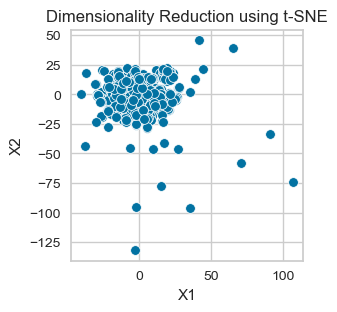

In [320]:
# t-SNE in 2D 
tsne = TSNE(n_components = 2, random_state = 1) 

# Convert embeddings to a DF
df_tsne = pd.DataFrame(tsne.fit_transform(condensed_data_dummies), columns = ['X1', 'X2'])

# Plot in 2D
plt.figure(figsize = (3,3))

sns.scatterplot(x = 'X1', y = 'X2', data = df_tsne)

plt.title("Dimensionality Reduction using t-SNE")

plt.show()

**Observations:** From the dimensionality reduction using t-SNE, there is one big cluster, however, it does not provide valuable insight.

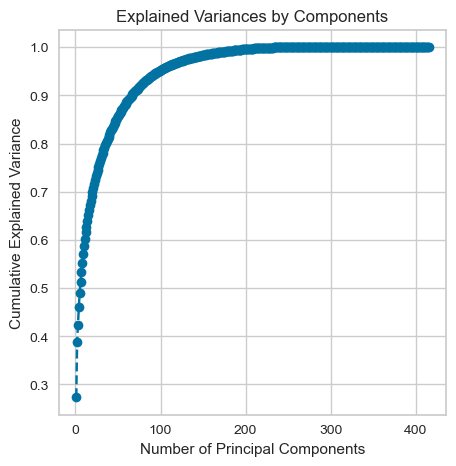

In [321]:
# Define number of principal components to generate
n = min(condensed_data_dummies.shape)

# Find principal components for the scaled data
pca = PCA(n_components = n, random_state = 1)

df_pca = pd.DataFrame(pca.fit_transform(condensed_data_dummies))

# Percentage of variance explained by each principal component
exp_var = pca.explained_variance_ratio_

# Plot cumulative explained variance by principal components
plt.figure(figsize = (5, 5))

plt.plot(range(1, n+1), pca.explained_variance_ratio_.cumsum(), marker = 'o', linestyle = '--')

plt.title("Explained Variances by Components")

plt.xlabel("Number of Principal Components")

plt.ylabel("Cumulative Explained Variance")

plt.show()

**Observations:** 200 Principal Components explain 100% of the variance in the data.

In [322]:
# Using the first 200 PCs
df_pca1 = pd.DataFrame(np.round(pca.components_.T[:, :200], 2), index = condensed_data_dummies.columns)

In [323]:
df_pca1

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199
"(R)-2,3-Dihydroxy-isovalerate",0.03,0.02,0.02,0.01,0.06,0.00,0.09,-0.00,0.01,0.04,-0.11,-0.08,0.03,-0.06,0.06,-0.00,-0.00,0.01,-0.02,-0.03,-0.04,-0.01,-0.03,0.02,0.01,0.02,0.07,-0.00,-0.01,0.04,-0.00,0.01,0.06,-0.00,0.11,-0.08,0.08,0.07,0.01,0.02,-0.02,0.02,0.04,0.01,0.18,0.14,-0.08,-0.05,-0.03,0.10,0.01,-0.05,-0.03,-0.02,0.05,0.07,0.03,-0.03,0.01,-0.02,0.04,0.03,-0.12,-0.04,-0.04,0.08,-0.07,-0.01,-0.03,-0.02,0.00,-0.07,0.03,-0.01,0.09,-0.03,0.06,0.06,0.01,-0.06,-0.13,-0.00,-0.01,-0.08,-0.18,-0.06,0.01,-0.07,-0.07,0.20,0.05,0.25,0.00,-0.04,-0.12,-0.12,0.02,-0.11,-0.04,0.02,-0.01,-0.06,-0.18,-0.18,-0.05,0.07,-0.19,0.17,0.34,0.10,-0.16,0.11,0.02,0.03,0.01,0.15,-0.09,0.08,-0.05,0.03,-0.04,-0.16,-0.11,0.04,0.17,0.01,-0.03,0.01,-0.11,-0.06,0.02,-0.02,-0.03,0.02,-0.02,-0.13,-0.01,-0.07,0.00,-0.09,0.04,0.09,-0.04,0.04,0.03,-0.00,-0.03,-0.02,-0.01,0.03,-0.00,0.02,0.05,0.08,0.05,0.08,0.01,0.04,-0.01,0.04,0.07,0.02,0.02,-0.00,0.04,-0.01,0.01,0.06,-0.03,-0.01,-0.02,0.02,-0.0,-0.0,-0.0,0.0,0.03,-0.04,-0.01,0.01,0.02,-0.02,-0.03,-0.01,-0.01,-0.00,0.02,-0.04,0.03,0.02,0.04,-0.00,-0.01,-0.01,0.01,-0.01,0.02,0.01,-0.04,0.03
(R)-2-Hydroxycaprylic acid,0.02,0.03,-0.02,-0.01,-0.00,-0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00,0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,-0.00,-0.00,0.00,-0.00,-0.00,-0.00,-0.00,-0.00,0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00,-0.00,-0.00,-0.00,-0.00,0.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00,0.00,0.00,0.00,0.00,-0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00,0.00,-0.00,-0.00,0.00,0.00,-0.00,0.00,-0.00,0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00,0.00,0.00,0.00,0.00,-0.00,0.00,0.00,-0.00,-0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00,0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00,0.00,-0.00,-0.00,0.00,0.00,-0.00,-0.00,-0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00,0.00,-0.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00,-0.00,0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00,-0.00,0.00,0.00,-0.00,0.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00,-0.00,-0.00,-0.00,-0.00,-0.00,0.00,0.00,-0.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00,-0.00,0.00,0.00,0.00,0.00,0.00,0.00,-0.00,0.00,0.00,0.00,-0.00,-0.0,-0.0,-0.0,-0.0,-0.00,0.00,0.00,0.00,0.00,-0.00,-0.00,0.00,0.00,0.00,0.00,0.00,-0.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00,0.00,-0.00,0.00,0.00,-0.00
(R)-Salsolinol,0.02,0.03,-0.01,-0.00,0.00,-0.00,-0.01,0.01,0.01,-0.00,0.01,0.01,0.01,0.02,0.01,0.02,-0.02,0.01,0.02,-0.00,0.02,-0.03,0.01,-0.05,0.00,0.02,0.02,0.03,-0.01,0.01,0.13,0.06,-0.01,0.03,-0.01,-0.02,0.03,-0.06,0.02,0.01,-0.07,-0.03,0.05,0.07,-0.03,-0.05,-0.07,-0.04,0.03,0.00,-0.01,-0.01,0.01,-0.02,0.05,0.06,-0.09,0.01,-0.02,0.04,0.02,0.02,-0.04,-0.06,0.03,-0.02,-0.06,-0.04,-0.00,0.06,0.12,-0.00,0.04,-0.03,0.05,0.06,0.03,0.02,-0.04,-0.02,0.03,-0.02,0.01,0.01,-0.02,-0.02,-0.05,-0.00,-0.01,-0.03,-0.08,0.05,-0.00,0.05,0.07,-0.03,0.03,0.08,0.08,-0.06,-0.03,0.05,0.02,-0.05,-0.02,-0.08,-0.00,0.02,-0.00,-0.04,0.06,-0.05,-0.00,0.01,-0.08,0.01,0.01,0.00,-0.00,-0.02,0.03,-0.02,-0.05,-0.01,0.03,0.04,-0.06,0.09,0.02,0.01,-0.02,-0.08,0.02,0.01,-0.05,-0.04,0.05,-0.01,0.00,-0.05,-0.02,-0.06,0.05,-0.03,0.04,0.03,-0.06,-0.07,0.07,-0.09,-0.08,-0.07,-0.02,-0.05,0.03,0.01,0.11,0.06,0.01,-0.11,-0.09,-0.14,0.04,0.03,0.00,0.03,-0.01,0.13,-0.09,0.01,-0.11,-0.10,-0.0,-0.0,-0.0,-0.0,0.11,-0.05,0.04,-0.11,-0.17,0.04,-0.11,-0.30,0.42,0.14,-0.09,-0.0

In [324]:
def color_high(val):
    if val <= -0.10:
        return 'background: pink'
    
    elif val >= 0.10:
        return 'background: skyblue'   

In [325]:
def pc_high(PC):
    df_pc = pd.DataFrame(df_pca1[PC].loc[abs(df_pca1[PC]) >= 0.10].sort_values(ascending=False))
    return df_pc.style.applymap(color_high)

pc_high(0)

,0
Glycine,0.110000
L-Leucine,0.110000
L-Phenylalanine,0.110000
L-Threonine,0.110000
L-Valine,0.110000
L-Alanine,0.100000
L-Glutamine,0.100000
L-Isoleucine,0.100000
L-Lysine,0.100000
L-Proline,0.100000


**Observations:** PC1 is mainly related to Amino Acids. Potentially disorders involving Amino Acids metabolism.

In [326]:
pc_high(1)

,1
L-Glutamic acid,-0.100000
Choline,-0.100000
Betaine,-0.110000
L-Histidine,-0.110000
L-Lactic acid,-0.110000
L-Arginine,-0.110000
L-Lysine,-0.120000
Ornithine,-0.120000
L-Proline,-0.130000
L-Serine,-0.130000


**Observations:** PC2 is completely the opposite of PC1, mainly unfavoring the Amino Acids. As expected since Principal Components are orthogonal to each other.

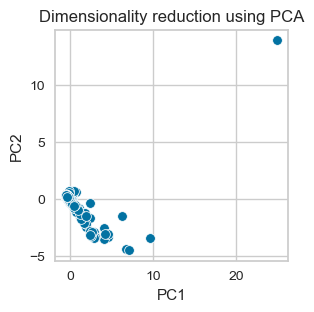

In [327]:
# Visualize data in 2D using first two PCs.
plt.figure(figsize = (3,3))

sns.scatterplot(x = df_pca[0], y = df_pca[1])

plt.xlabel("PC1")

plt.ylabel("PC2")

plt.title("Dimensionality reduction using PCA")

plt.show()

In [328]:
pca = PCA(n_components = 200, random_state = 1)

df_pca200 = pd.DataFrame(pca.fit_transform(condensed_data_dummies))

In [329]:
df_pca200

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199
0,-0.497151,0.349418,-0.000835,-0.056636,0.044666,0.073147,-0.131764,0.084448,-0.191718,0.184541,0.252061,0.207879,-0.094952,-0.193042,0.345456,0.366563,0.141299,-0.035625,0.235390,0.176308,-0.519521,0.081440,-0.001081,-0.274415,-0.139148,-0.641335,0.345373,0.375754,-0.166113,0.500444,-0.457299,0.365723,-0.788978,-0.231879,-0.066830,-0.538749,-0.082702,0.153465,-0.029667,0.104583,0.567718,-0.203900,-0.013779,-0.197616,0.051457,0.002879,0.039472,0.137992,-0.100429,-0.319084,-0.155588,-0.124825,-0.013282,0.155680,0.190764,0.093279,-0.295906,-0.153957,-0.012684,-0.241872,-0.117831,-0.027164,-0.044628,0.031054,0.071325,-0.129925,0.112435,-0.218683,-0.139277,-0.021870,0.158654,0.050573,-0.164497,-0.009625,0.190381,-0.055272,-0.005921,-0.206894,-0.004514,0.054342,0.066365,0.072429,0.006192,0.097654,0.024833,0.056557,-0.063646,0.128085,0.082479,0.123465,0.047202,0.061602,-0.162211,0.026945,-0.047852,-0.000430,-0.103042,-0.169613,0.152038,-0.137203,0.036079,-0.056037,-0.155976,-0.063600,0.116139,0.055592,0.044209,-0.011340,0.102803,-0.190263,0.457908,-0.074409,0.057105,-0.272057,0.282614,-0.231995,-0.081439,0.612719,-0.243406,-0.081497,0.083729,-0.174506,-0.065839,-0.036327,0.026483,-0.036332,-0.003969,-0.015371,0.065550,0.037783,-0.031244,-0.018326,-0.016130,-0.036479,-0.064701,0.070172,-0.064391,-0.030717,0.106688,0.062490,-0.120913,0.056542,-0.041532,0.076297,0.018075,-0.034568,-0.007017,0.072266,-0.035502,-0.025515,0.001946,-0.031713,-0.011618,0.042167,-0.066734,0.007061,-0.001919,0.000803,-0.032823,-0.053479,-0.077741,-0.013369,-0.059182,0.025825,-0.053042,-0.008389,0.002441,0.002093,-0.061240,0.021332,-0.050612,-0.039178,-0.000127,-0.001310,-0.015387,0.001652,0.037435,-0.009958,-0.041172,0.027321,-0.032891,0.044721,0.025167,0.057938,0.009778,0.011856,0.039127,0.004278,-0.053608,-0.040963,0.118087,0.020419,-0.002020,0.067725,0.066311,-0.022339,0.022586,0.015666,-0.045388,-0.109265
1,-0.308121,0.027307,-0.217655,0.091297,0.097055,-0.125775,0.195005,-0.323266,0.067546,-0.006689,-0.569920,0.081564,0.148256,0.314335,-0.064549,-0.149091,0.318879,0.401281,0.005979,-0.119748,0.020668,0.224360,-0.216707,-0.040859,-0.134240,0.057688,0.364591,-0.209973,-0.080546,0.015535,0.073602,0.057913,0.201018,-0.195325,-0.349373,-0.131421,0.008984,0.091215,-0.027509,-0.332009,0.010126,-0.197350,0.092232,0.003051,0.011030,0.112307,-0.115480,0.138803,-0.212269,0.130424,0.065556,0.122962,0.160626,0.135550,-0.047353,-0.015193,-0.119054,-0.190697,0.051580,-0.024888,0.112641,-0.028670,0.027480,-0.311584,-0.158354,-0.145706,0.136022,-0.026159,0.049718,-0.054715,-0.060142,-0.000616,-0.222008,-0.060355,-0.019271,0.098089,0.029824,-0.000269,-0.033724,0.154806,0.058868,0.039839,-0.240889,0.088950,0.171165,0.138426,-0.141345,0.052700,0.093483,0.088899,0.198112,-0.105946,-0.108461,0.003746,-0.018268,0.057106,0.037720,0.048819,0.061150,-0.067498,-0.015413,-0.039255,0.153667,0.036177,0.018807,-0.123066,-0.004082,-0.070950,-0.087513,-0.008237,-0.079095,-0.034866,-0.075560,-0.010599,-0.058270,0.039396,-0.024045,0.041717,-0.053518,-0.051826,0.016306,0.034397,-0.072494,0.093094,0.036207,-0.005465,-0.006064,0.048978,-0.077694,-0.052386,0.001552,-0.016544,-0.027477,0.054858,0.018452,-0.071674,-0.001546,0.030374,0.011536,0.013604,-0.002682,-0.003006,-0.015252,0.058056,0.025361,0.000527,-0.025317

For n_clusters: 2, the SSE is 3331.2878918373626
For n_clusters: 3, the SSE is 2722.9335054688568
For n_clusters: 4, the SSE is 2561.5247712199102
For n_clusters: 5, the SSE is 2413.6618377808413
For n_clusters: 6, the SSE is 2336.5209704546005
For n_clusters: 7, the SSE is 2258.6560557568537
For n_clusters: 8, the SSE is 2203.7191889535516
For n_clusters: 9, the SSE is 2116.2822198036747
For n_clusters: 10, the SSE is 2058.4616489698437
For n_clusters: 11, the SSE is 2009.811670113414
For n_clusters: 12, the SSE is 1932.0112545276609
For n_clusters: 13, the SSE is 1875.9885557209764
For n_clusters: 14, the SSE is 1844.1552149770118


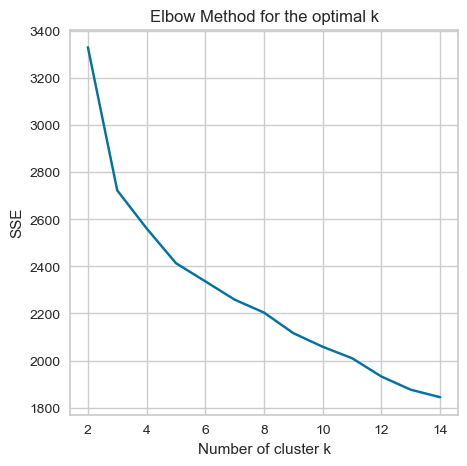

In [330]:
# Initialize dict to store SSE for each k
sse = {} 

# Find optimal n_clusters 
# Use inertia attribute for SSE and store 
for k in range(2, 15):
    kmeans = KMeans(n_clusters = k, random_state = 1).fit(df_pca200)
    sse[k] = kmeans.inertia_
    print(f"For n_clusters: {k}, the SSE is {sse[k]}")

# Elbow plot
plt.figure(figsize = (5,5))

plt.plot(list(sse.keys()), list(sse.values()), 'bx-')

plt.xlabel("Number of cluster k")

plt.ylabel("SSE")

plt.title("Elbow Method for the optimal k")

plt.show()

For n_clusters: 2, the Silhouette score is 0.8816342173906702
For n_clusters: 3, the Silhouette score is 0.6133741139431175
For n_clusters: 4, the Silhouette score is 0.5884006705628808
For n_clusters: 5, the Silhouette score is 0.5603149286018396
For n_clusters: 6, the Silhouette score is 0.5500195825346031
For n_clusters: 7, the Silhouette score is 0.24992359337785958
For n_clusters: 8, the Silhouette score is 0.4512802385473312
For n_clusters: 9, the Silhouette score is 0.19466374610331025
For n_clusters: 10, the Silhouette score is 0.47441499328600983
For n_clusters: 11, the Silhouette score is 0.19534493755546334
For n_clusters: 12, the Silhouette score is 0.4487666032434545
For n_clusters: 13, the Silhouette score is 0.20190931092309056
For n_clusters: 14, the Silhouette score is 0.20332375103019856


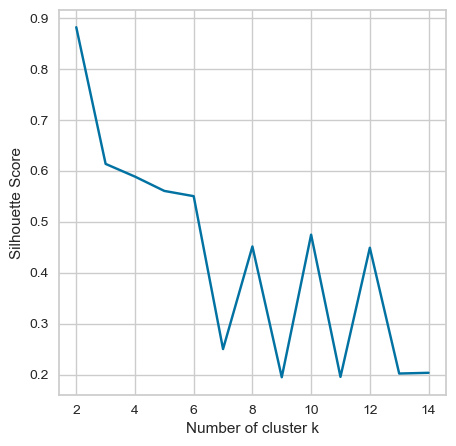

In [331]:
def sil_plot(algo_name):    
    # Initialize dict to store Silhouette score for each k
    sil_score = {} 

    # Iterate for k, fit scaled data to algorithm, store Silhouette score 
    for k in range(2, 15):
        if algo_name == "KMeans":
            algo = KMeans(n_clusters = k, random_state = 1).fit(df_pca200)
            
        if algo_name == "KMedoids":
            algo = KMedoids(n_clusters = k, random_state = 1).fit(df_pca200)
            
        if algo_name == "GMM":
            algo = GaussianMixture(n_components = k, random_state = 1).fit(df_pca200)

        labels = algo.predict(df_pca200)

        sil_score[k] = silhouette_score(df_pca200, labels)

        print(f"For n_clusters: {k}, the Silhouette score is {sil_score[k]}") 

    # Silhouette plot
    plt.figure(figsize = (5,5))

    plt.plot(list(sil_score.keys()), list(sil_score.values()), 'bx-')

    plt.xlabel("Number of cluster k")

    plt.ylabel("Silhouette Score")

    plt.show()

sil_plot("KMeans")

In [332]:
# Using KMeans Clustering Algorithm, n=12 cancers
kmeans = KMeans(n_clusters = 12, random_state = 1) 

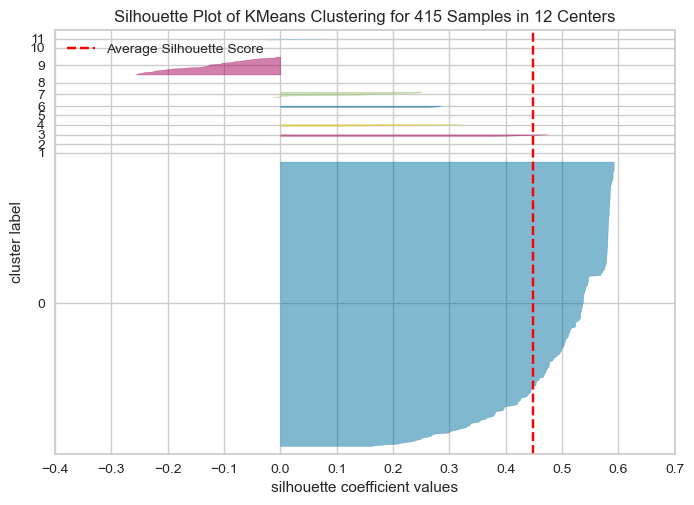

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 415 Samples in 12 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [333]:
# Silhouette plot for clusters
visualizer = SilhouetteVisualizer(kmeans, colors='yellowbrick', random_state = 1)
visualizer.fit(df_pca200)        
visualizer.show()

**Observations:** Clustering is very bad and unevenly distributed. Clustering on sparse data may not be ideal.

### Using Network Graph

In [334]:
edge_list = final_df.filter(["Condition", "Metabolite"])

In [335]:
edge_list

,Condition,Metabolite
0,11Β-OHD,Androstenedione
1,11Β-OHD,Testosterone
2,11Β-OHD,Tetrahydrodeoxycorticosterone
3,11Β-OHD,Dehydroepiandrosterone sulfate
4,11Β-OHD,Vaccenic acid
...,...,...
4360,ZELLWEGER SYNDROME,Pipecolic acid
4361,ZELLWEGER SYNDROME,Phytanic acid
4362,Α-AMINOADIPIC/Α-KETOADIPIC ACIDURIA,L-Lysine
4363,Α-AMINOADIPIC/Α-KETOADIPIC ACIDURIA,2-Hydroxyadipic acid


In [336]:
edge_list.Condition.nunique()

415

In [337]:
edge_list.Metabolite.nunique()

901

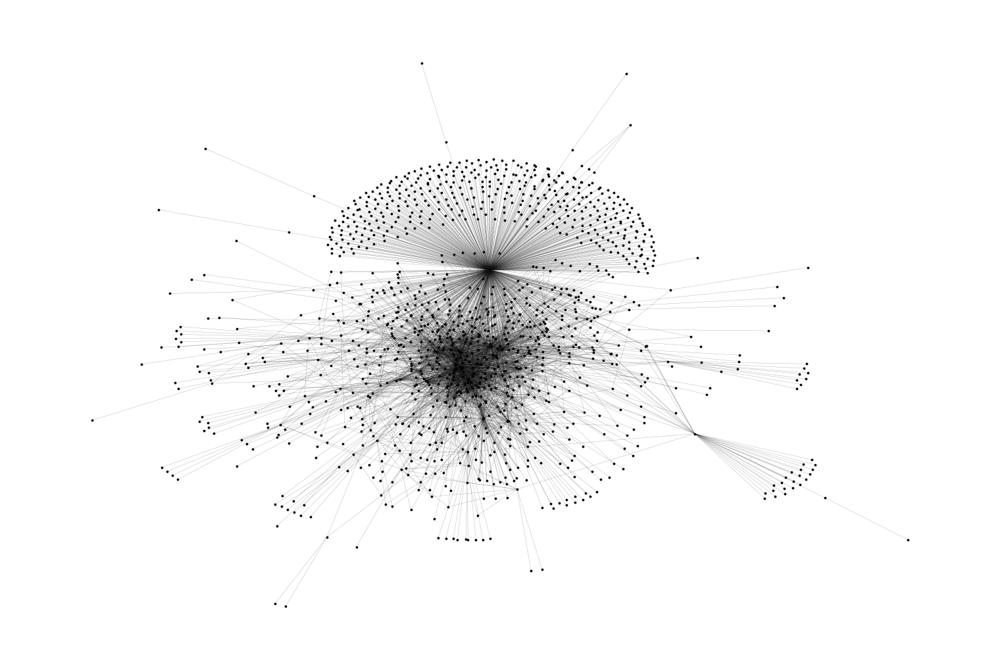

In [338]:
# Set random seed for reproducibility
np.random.seed(900)

# Draw Graph
G = nx.from_pandas_edgelist(edge_list, "Condition", "Metabolite")

plt.figure(figsize = (15, 10))

options = {
    "node_color": "black",
    "node_size": 5,
    "linewidths": 0.5,
    "width": 0.1,
}

nx.draw(G, with_labels = False, **options)

plt.show()

In [339]:
# Condition Nodes
sorted_conditions = list(sorted(set(edge_list.Condition)))

# Metabolite Nodes
sorted_metabolites = list(sorted(set(edge_list.Metabolite)))

# Edges between Condition and Metabolite
edges = [(row['Condition'], row['Metabolite']) for _, row in edge_list.iterrows()]

In [340]:
# Create Bipartite Graph
B = nx.Graph()

# Add nodes with node attribute "bipartite"
B.add_nodes_from(sorted_conditions, bipartite=0)
B.add_nodes_from(sorted_metabolites, bipartite=1)

# Add edges
B.add_edges_from(edges)

In [341]:
condition_nodes, metabolite_nodes = bipartite.sets(B)

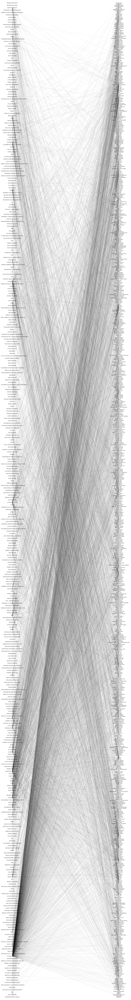

In [342]:
# Draw Bipartite Graph
plt.figure(figsize = (13, 100))
np.random.seed(900)

options = {
    "node_color": "none",
    "node_size": 50,
    "linewidths": 0.25,
    "width": 0.1,
    "font_size": 7,
}

pos = nx.bipartite_layout(B, condition_nodes)

nx.draw(B, pos = pos, with_labels = True, **options)

plt.ylim(-0.55, 0.55)

plt.show()

In [343]:
# Community Detection
partition = community_louvain.best_partition(B, random_state = 1)

partition_df = pd.DataFrame([partition]).T.reset_index()

partition_df.columns = ["Node", "Community"]

partition_df

,Node,Community
0,11Β-OHD,0
1,"2,4-DIENOYL-COA REDUCTASE DEFICIENCY",0
2,2-HYDROXYGLUTARIC ACIDURIA,1
3,2-KETOGLUTARATE DEHYDROGENASE COMPLEX DEFICIENCY,1
4,2-METHYL-3-HYDROXYBUTYRYL-COA DEHYDROGENASE DEFICIENCY,0
...,...,...
1311,scyllo-Inositol,0
1312,trans-Aconitic acid,3
1313,trizma acetate,3
1314,xi-10-Hydroxyoctadecanoic acid,6


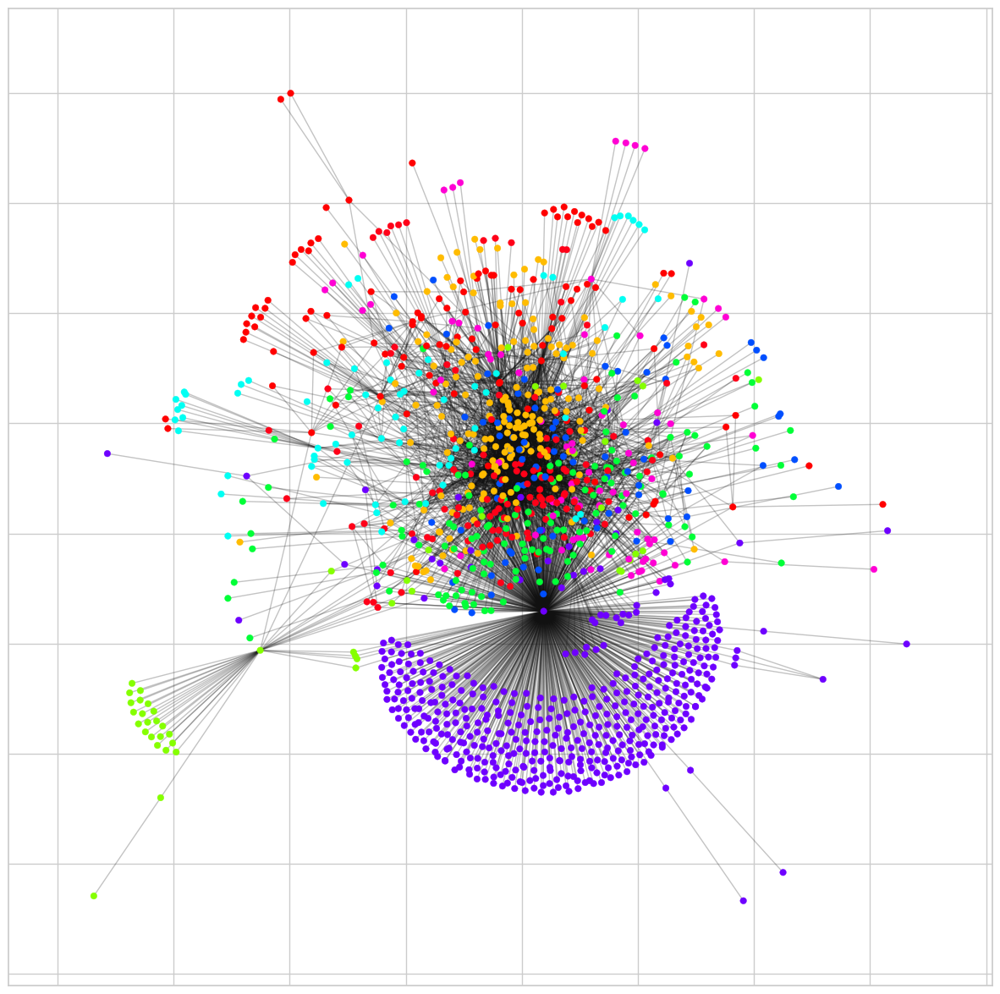

In [344]:
plt.figure(figsize = (15, 15))
np.random.seed(900)

# Nodes color according to partition
cmap = cm.get_cmap('hsv', max(partition.values()) + 1)

# Draw Graph
pos = nx.spring_layout(B)

nx.draw_networkx_nodes(B, pos, nodelist=partition.keys(), node_size=30, cmap=cmap, node_color=list(partition.values()))
nx.draw_networkx_edges(B, pos, alpha=0.25)
plt.show()

In [345]:
sorted(partition_df.Community.unique())

[0, 1, 2, 3, 4, 5, 6, 7, 8]

In [346]:
pd.set_option('display.max_rows', None)

In [347]:
partition_df[partition_df.Community == 0]

,Node,Community
0,11Β-OHD,0
1,"2,4-DIENOYL-COA REDUCTASE DEFICIENCY",0
4,2-METHYL-3-HYDROXYBUTYRYL-COA DEHYDROGENASE DEFICIENCY,0
5,2-METHYLBUTYRYL-COA DEHYDROGENASE DEFICIENCY (SBACDD),0
6,21-HYDROXYLASE DEFICIENCY,0
10,3-HYDROXYISOBUTYRIC ACIDURIA,0
11,3-HYDROXYISOBUTYRYL-COA HYDROLASE DEFICIENCY,0
17,ACAD9 DEFICIENCY,0
18,ACUTE LIVER FAILURE,0
20,ACUTE MYELOGENOUS LEUKEMIA (AML),0


**Observations:** Community 0 is mainly capturing Endocrine Disorders (Adrenal glands, Pancreas, Gonads), Hepatobiliary Disorders, and Mitochondrial Disorders. There is a strong relationship between hepatic (liver) disorders and adrenal disorders, as the liver and adrenal glands are closely linked in their functions and the hormones they produce, and disorders affecting one can have a significant impact on the other. The liver plays a crucial role in the metabolism of multiple endocrine hormones, including those produced by the adrenal glands, such as cortisol and aldosterone. 
Adrenal disorders can lead to elevated levels of cortisol in the body, which can have a negative impact on liver function. Prolonged exposure to high levels of cortisol can cause fatty liver disease, which can progress to more serious conditions such as cirrhosis and liver failure.

Adrenal glands also play a role in regulating glucose metabolism in the body. Adrenal disorders can also affect blood sugar levels through cortisol and catecholamines (epinephrine and norepinephrine). Cortisol helps to maintain blood sugar levels by promoting the breakdown of stored glycogen into glucose and by stimulating gluconeogenesis. Excess cortisol production leads to hyperglycemia whereas insufficient cortisol production leads to hypoglycemia. 

Adrenal disorders can also lead to an increase in the levels of triglycerides and cholesterol in the blood, leading to hyperlipidemia.

Mitochondrial disorders cause metabolim problems as well. Lactic acidosis (high concentration of Lactic acid) is a state that is mainly associated with mitochondrial disorders.

*Examples of disorders*

Endocrine disorders:
- CAH (11Β-OHD, 21-HYDROXYLASE DEFICIENCY)
- CONGENITAL ADRENAL INSUFFICIENCY (46,XY)
- CUSHING'S SYNDROME
- GLUCAGON DEFICIENCY	
- HIRSUTISM
- HYPOADRENOCORTICISM
- HYPOGONADISM
- LIPOID CAH	
- PCOS
- WOODHOUSE-SAKATI SYNDROME

Hepatobiliary disorders:
- ACUTE LIVER FAILURE
- CBAS1
- CHOLESTERYL ESTER STORAGE DISEASE
- CRIGLER-NAJJAR SYNDROME TYPE I
- FRUCTOSE INTOLERANCE, HEREDITARY
- GALLSTONE DISEASE

Mitochondrial disorders:
- CPEO
- INFANTILE MITOCHONDRIAL DISEASE	
- LEBER OPTIC ATROPHY AND DYSTONIA
- LEIGH SYNDROME
- MELAS
- MERRF
- MTP DEFICIENCY
- MYOPATHY WITH LACTIC ACIDOSIS
- SENGERS SYNDROME

Glucose regulation disorder:
- DIABETES
- HYPOGLYCEMIA
- FRUCTOSE-1,6-BISPHOSPHATASE DEFICIENCY

Lipid regulation disorder:
- HYPERCHOLESTEROLEMIA
- HYPERLIPIDEMIA
- LCAT DEFICIENCY

In [348]:
partition_df[partition_df.Community == 1]

,Node,Community
2,2-HYDROXYGLUTARIC ACIDURIA,1
3,2-KETOGLUTARATE DEHYDROGENASE COMPLEX DEFICIENCY,1
9,3-HYDROXYISOBUTYRIC ACID DEHYDROGENASE DEFICIENCY,1
14,3-PHOSPHOGLYCERATE DEHYDROGENASE DEFICIENCY,1
21,ACUTE SEIZURES,1
32,ALZHEIMER'S DISEASE,1
35,AMISH LETHAL MICROCEPHALY,1
39,ANOXIA,1
47,ARSACS,1
48,AS/RA,1


**Observations:** Community 1 is related to Amino Acids metabolism disorders, Urea cycle disorders, Pyruvate metabolism disorders, and Neurological disorders. Urea cycle disorders causes buildup of ammonia in the blood (hyperammonemia). Seizures  can occur due to the accumulation of ammonia and amino acids. Amino Acids metabolism disorder can cause multiple amino acidemia/aciduria. Hyperammonemia can also lead to cardiomyopathy and heart failure.  

Amino acids metabolism disorders:
- 2-HYDROXYGLUTARIC ACIDURIA
- CYSTINURIA
- DIBASIC AMINO ACIDURIA I	
- HEREDITARY TYROSINEMIA	
- HISTIDINURIA
- HYDROXYPROLINEMIA
- HYPERGLYCINURIA
- HYPERLYSINEMIA I	
- HYPERLYSINEMIA II	
- HYPERLYSINURIA	
- HYPERMETHIONINEMIA	
- HYPERORNITHINEMIA	
- HYPERPHENYLALANINEMIA	
- HYPERPROLINEMIA	
- HYPERVALINEMIA
- IMINOGLYCINURIA
- MALONIC/METHYLMALONIC ACIDURIA	
- SARCOSINEMIA

Urea cycle disorders:
- CARBAMOYL PHOSPHATE SYNTHETASE DEFICIENCY
- GOUT
- HI/HA SYNDROME	
- NAGS DEFICIENCY

Pyruvate metabolism disorders:
- MITOCHONDRIAL PYRUVATE CARRIER DEFICIENCY
- PDHD
- PDHPD
- PYRUVATE CARBOXYLASE DEFICIENCY

Neurological disorders:
- ALZHEIMER'S DISEASE
- ARSACS
- ACUTE SEIZURES	
- EPILEPSY	
- FRIEDREICH'S ATAXIA
- FOCAL EPILEPSY
- OLIVOPONTOCEREBELLAR ATROPHY (OPCA)

Cancers in this community are :
- BREAST CANCER
- LEUKEMIA
- OESOPHAGEAL CANCER	
- OESOPHAGO-GASTRIC CANCER	
- ORAL CANCER

In [349]:
partition_df[partition_df.Community == 2]

,Node,Community
7,27-HYDROXYLASE DEFICIENCY,2
16,ABETALIPOPROTEINEMIA,2
60,BPH,2
139,ENDOMETRIAL CANCER,2
307,OBESITY,2
355,PROSTATE CANCER,2
405,VITAMIN E DEFICIENCY,2
430,1-Kestose,2
448,17a-Ethynylestradiol,2
462,2-Hydroxyglutarate,2


**Observations:** Community 2 is related to vitamin E deficiency, and prostate disorders.
Vitamin E plays an important role in protecting cells from oxidative damage. Oxidative damage can contribute to the development of cancer. According to some research, Beta-carotene and lycopene are inversely associated with the risk of endometrial cancer (Acta Obstet Gynecol Scand. 2009;88(4):434-9. doi: 10.1080/00016340902767187).

Vitamin E deficiency:
- ABETALIPOPROTEINEMIA
- VITAMIN E DEFICIENCY

Prostate disorders:
- BPH
- PROSTATE CANCER

In [350]:
partition_df[partition_df.Community == 3]

,Node,Community
8,3-HYDROXYDICARBOXYLIC ACIDURIA,3
28,AIDS,3
37,ANEMIA,3
38,ANOREXIA,3
41,APPENDICITIS,3
59,BLADDER CANCER,3
65,BRUNNER SYNDROME,3
70,CANCER (MBD),3
71,CANCER - ASSORTED TYPES,3
73,CARDIOVASCULAR RISK,3


**Observations:** Community 3 is related to gastrointestinal disorders, Carbohydrate metabolism disorders, and Fatty Acid oxidation disorders. Malabsorption disorders are often asscoiated with inflammation and bleeding, leading to anemia in most cases.

Gastrointestinal disorders:
- ANOREXIA
- MALNUTRITION (KWASHIORKOR/MARASMUS)	
- SMALL INTESTINE MALABSORPTION
- ANEMIA
- APPENDICITIS
- EOSINOPHILIC ESOPHAGITIS	
- GASTRIC CANCER	
- GERD

Metabolism disorders:
- METABOLIC SYNDROME
- HYPERTENSION
- CARDIOVASCULAR RISK	

Carbohydrate metabolism disorders:
- GALACTOSEMIA
- HYPERGALACTOSEMIA (HEPATIC)	
- PENTOSURIA
- RIBOSE-5-PHOSPHATE ISOMERASE DEFICIENCY


Fatty Acid oxidation disorders:
- MCAD DEFICIENCY	
- SCAD DEFICIENCY
- 3-HYDROXYDICARBOXYLIC ACIDURIA
- CARNITINE-ACYLCARNITINE TRANSLOCASE DEFICIENCY

In [351]:
partition_df[partition_df.Community == 4]

,Node,Community
12,3-MCC DEFICIENCY,4
15,5-OXOPROLINASE DEFICIENCY,4
19,ACUTE LYMPHOBLASTIC LEUKEMIA,4
22,ADA DEFICIENCY,4
23,ADENOSINE KINASE DEFICIENCY,4
27,ADSL DEFICIENCY,4
36,AMYOTROPHIC LATERAL SCLEROSIS,4
42,ARGINASE DEFICIENCY,4
43,ARGININEMIA,4
51,BARTTER SYNDROME,4


**Observations:** Community 4 is related to Neurological disorders and Purine/Pyrimidine metabolism disorders. Purine/Pyrimidine deficiencies mostly cause Neurological problems.  

Neurological disorders:
- ADSL DEFICIENCY
- 3-MCC DEFICIENCY
- AMYOTROPHIC LATERAL SCLEROSIS
- BETA-UREIDOPROPIONASE DEFICIENCY
- CANAVAN DISEASE
- CRUETZFELDT-JAKOB DISEASE	
- MOTOR NEURON DISEASE (MND)		
- MULTIPLE SCLEROSIS	
- PELIZAEUS MERZBACHER DISEASE	
- PERIPHERAL NEUROPATHY		
- POLYNEUROPATHY
- PROGRESSIVE SUPRANUCLEAR PALSY

Purine/Pyrimidine metabolism disorders:
- ADA DEFICIENCY	
- ADENOSINE KINASE DEFICIENCY
- LESCH-NYHAN SYNDROME
- XANTHINURIA
- PHOSPHORIBOSYLPYROPHOSPHATE SYNTHETASE SUPERACTIVITY

In [352]:
partition_df[partition_df.Community == 5]

,Node,Community
13,3-METHYLGLUTACONIC ACIDURIA,5
24,ADPKD,5
33,AMINOACIDURIA,5
44,ARGININOSUCCINIC ACIDURIA,5
46,AROMATIC L-AMINO ACID DECARBOXYLASE DEFICIENCY,5
58,BIOTINIDASE DEFICIENCY,5
64,BROWN-VIALETTO-VAN LAERE SYNDROME 1,5
129,DIMETHYLGLYCINURIA,5
143,EPITHELIAL OVARIAN CANCER,5
144,ETHANOLAMINURIA,5


**Observations:** Community 5 is related to Branched Amino Acids metabolism disorders.

- MSUD
- PHENYLKETONURIA
- TYROSINEMIA I	 
- PROPIONIC ACIDEMIA

In [353]:
partition_df[partition_df.Community == 6]

,Node,Community
34,AMINOACYLASE I DEFICIENCY,6
49,ASTHMA,6
92,COLORECTAL ADENOMA,6
93,COLORECTAL CANCER,6
98,CORONARY ARTERY DISEASE,6
128,DIHYDROPYRIMIDINASE DEFICIENCY,6
146,FABRY DISEASE,6
169,GLUTAMATE FORMIMINOTRANSFERASE DEFICIENCY,6
183,HAWKINSINURIA,6
205,HUNTINGTON'S DISEASE,6


**Observations:** Community 6 is related to lipid metabolism disorders. Some research suggest that lipid metabolism may play a role in the development and progression of colorectal cancer. Some studies have found that dysregulation of lipid metabolism may contribute to the formation of tumors in the colon and rectum.
Abnormal lipid metabolism may lead to the accumulation of lipids in cells and tissues, which can contribute to the development of tumors.

- CORONARY ARTERY DISEASE	
- FABRY DISEASE	
- PHYTOSTEROLEMIA	
- SITOSTEROLEMIA	

In [354]:
partition_df[partition_df.Community == 7]

,Node,Community
25,ADRENOLEUKODYSTROPHY,7
26,ADRENOMYELONEUROPATHY,7
31,ALPHA-METHYLACYL-COA RACEMASE DEFICIENCY,7
83,CEREBROTENDINOUS XANTHOMATOSIS (CTX),7
84,CERVICAL CANCER,7
86,CHOLANGIOMA CANCER,7
114,DBP DEFICIENCY,7
122,DEPRESSION,7
163,GDM,7
188,HEPATITIS,7


**Observations:** Community 7 is related to Peroxisomal disorders, which leads to Fatty Acids buildup. Accumulation of Fatty Acdids in the body can cause many serious hepatobiliary disorders.

Peroxisomal disorders:
- ADRENOLEUKODYSTROPHY	
- ADRENOMYELONEUROPATHY	
- PEROXISOME BIOGENESIS DISORDER	
- REFSUM'S DISEASE	
- RHIZOMELIC CHONDRODYSPLASIA PUNCTATA	
- ZELLWEGER SYNDROME	

Hepatobiliary disorders:
- CHOLANGIOMA CANCER
- HEPATITIS	
- HEPATOCELLULAR CARCINOMA	
- LATHOSTEROLOSIS	
- LIVER CIRRHOSIS	

In [355]:
partition_df[partition_df.Community == 8]

,Node,Community
29,ALCOHOLISM,8
30,ALPHA-1-ANTITRYPSIN DEFICIENCY,8
50,AUTISM,8
54,BERGER'S DISEASE,8
56,BILIARY ATRESIA,8
57,BILIARY CIRRHOSIS,8
62,BREAST TUMOUR,8
79,CELIAC DISEASE,8
85,CERVICAL MYELOPATHY,8
87,CHOLECOHAL CYST,8


**Observations:** Community 8 is related to Hepatobiliary disorders and gastrointestinal disorders. Accumulation of uric acid can also cause Kidney disorders.

Gastrointestinal disorders:
- CELIAC DISEASE
- CROHN'S DISEASE	
- GI DISORDER-IFALD
- INFLAMMATORY BOWEL DISEASE
- ULCERATIVE COLITIS
- IRRITABLE BOWEL SYNDROME

Hepatobiliary disorders:
- ALPHA-1-ANTITRYPSIN DEFICIENCY
- BILIARY ATRESIA	
- BILIARY CIRRHOSIS	
- GLYCOGEN STORAGE DISEASE
- HEPATIC ENCEPHALOPATHY
- CHOLECOHAL CYST
- WILSON'S DISEASE
- INTRAHEPATIC BILIARY HYPOPLASIA
- NAFLD
- PORTAL VEIN OBSTRUCTION

Kidney disorders:
- BERGER'S DISEASE
- KIDNEY DISEASE

##### Using scraping in the Reference Disease Section
**Did NOT use**

In [356]:
# dfs = []

# metabolite_ids = list(metabolites_grouped.ID.unique())

# for metabolite_id in metabolite_ids:
    
#     url = f"https://hmdb.ca/metabolites/{metabolite_id}"
#     response = requests.get(url)
#     webpage = bs(response.content)
    
#     #print(metabolite_id)
    
#     try:
#         table = webpage.select("table.disease-table")[0]
#     except:
#         pass
        
        
#     table_rows = table.find_all("th")

#     diseases_list = [th.get_text().strip() for th in table_rows] 

#     df = pd.DataFrame({"Disease": diseases_list})
#     df["ID"] = f"{metabolite_id}"
#     dfs.append(df)

In [357]:
# Raw disease references for each metabolite found in Cancers
#associated_diseases = pd.concat(dfs, sort=False)

In [358]:
#associated_diseases.reset_index(drop=True, inplace=True)

associated_diseases.to_csv("./associated_diseases.csv", index=False)

In [359]:
#associated_diseases = pd.read_csv("../data/associated_diseases.csv")

In [360]:
#associated_diseases.rename(columns={"Disease": "Condition"}, inplace=True)

In [361]:
#associated_conditions = associated_diseases.groupby(["ID", "Condition"]).first().reset_index()

In [362]:
#to_drop = associated_conditions[associated_conditions.Condition == "Perillyl alcohol administration for cancer treatment"].index

In [363]:
#associated_conditions.drop(index=to_drop, axis=0, inplace=True)

In [364]:
#associated_conditions.reset_index(drop=True, inplace=True)

In [365]:
#associated_conditions

In [366]:
#associated_conditions.Condition.nunique()